In [1]:
from datetime import date
import os
from tqdm import tqdm

import yaml
import json

import requests
from bs4 import BeautifulSoup

import numpy as np
import pandas as pd
import pandas_datareader as pdr

from PIL import Image

import quandl
import yfinance as yf
from fredapi import Fred

import plotly
import plotly.graph_objects as go

from dotenv import load_dotenv

# create a .env file with QUANDL_TOKEN=xxxxxx
load_dotenv()
quandl_token = os.getenv('QUANDL_TOKEN')

print(f"numpy                {np.__version__:<20}")
print(f"pandas               {pd.__version__:<20}")
print(f"pandas_datareader    {pdr.__version__:<20}")
print(f"yfinance             {yf.__version__:<20}")
print(f"plotly               {plotly.__version__:<20}")


OUTPUT_PNG=True


numpy                1.25.2              
pandas               2.0.3               
pandas_datareader    0.10.0              
yfinance             0.2.28              
plotly               5.16.1              


### Awesome dataviz


- [BD Econ chartbook](https://github.com/bdecon/US-chartbook) [PDF](https://www.bd-econ.com/chartbook.pdf) (amazing 😎)

- [Visual Capitalist](https://www.visualcapitalist.com/)

### Official data
- [FRED](https://fred.stlouisfed.org/)
- [FRB](https://www.federalreserve.gov/data.htm)
- [OECD](https://data.oecd.org/) [Alt](https://www.oecd-ilibrary.org/statistics)
- [US Treasury](https://home.treasury.gov/)
- [BEA](https://www.bea.gov/data/economic-accounts/international)
- [US Government Open Data](https://data.gov/)
- [Conference Board](https://www.conference-board.org/data/)
- [Eurostat](https://ec.europa.eu/eurostat/data/database) [blog post](https://towardsdatascience.com/using-eurostat-statistical-data-on-europe-with-python-2d77c9b7b02b) 
- [ECB](https://sdw.ecb.europa.eu/)
- [World Bank](https://data.worldbank.org/) [blog post](https://blogs.worldbank.org/opendata/introducing-wbgapi-new-python-package-accessing-world-bank-data) [Alt](https://databank.worldbank.org/source/world-development-indicators)
- [IMF](https://data.imf.org/?sk=388dfa60-1d26-4ade-b505-a05a558d9a42) 
https://www.imf.org/external/datamapper/NGDP_RPCH@WEO/OEMDC/ADVEC/WEOWORLD
- [UN](http://data.un.org/Default.aspx) [Alt](https://unctadstat.unctad.org/EN/)
- [BIS](https://www.bis.org/statistics/index.htm?m=6%7C37)
- [ADB](https://data.adb.org/)
- [IDB](https://data.iadb.org/DataCatalog/Dataset)
- [WHO](https://apps.who.int/gho/data/node.home)

### Other data

- [Economy.com](https://www.economy.com/Freelunch/)
- [Trading Economics](https://tradingeconomics.com/)
- [NationMaster](https://www.nationmaster.com/)
- [Knoema](https://knoema.com/atlas)
- [IndexMundi](https://www.indexmundi.com/)


### Econ calendars

- [NY Fed](https://www.newyorkfed.org/research/calendars/nationalecon_cal.html)
- [FRED](https://fred.stlouisfed.org/releases/calendar)
- [MarketWatch](https://www.marketwatch.com/economy-politics/calendar)

### Free datasets

- https://datahub.io/collections/economic-data
- https://www.kaggle.com/datasets
- https://github.com/awesomedata/awesome-public-datasets
- https://datasetsearch.research.google.com/
- https://archive.ics.uci.edu/ml/index.php
- https://registry.opendata.aws/
- https://msropendata.com/


In [2]:
# TODO:

# color template
# import plotly.io as pio

# # naming a layout theme for future reference
# pio.templates["google"] = go.layout.Template(
#     layout_colorway=['#4285F4', '#DB4437', '#F4B400', '#0F9D58',
#                      '#185ABC', '#B31412', '#EA8600', '#137333',
#                      '#d2e3fc', '#ceead6']
# )

# # setting Google color palette as default
# pio.templates.default = "google"

# would be nice to write a generic pandas shift by 1 year based on frequency of the dataframe
# get all data incl future from fred
# yield curve chart, other custom charts
# recession shading

# break down retail sales, consumption, employment, price with bar charts or composition flow over time
# change in composition of labor force , status over time

# jolts hires/fires/quits/openings

# hours worked that tracks with gdp

# stock valuations, fed model, shiller model, dividend yield, pe yield, 
# real yields

# dot plot median forecast going out 3 years
# Yield curve
# contributions to GDP
# contributions to inflation
#     #               A466RD3Q052SBEA
# #                 Profit per unit of real gross value added of nonfinancial corporate business: Corporate profits after tax with IVA and CCAdj (unit profits from current production) (A466RD3Q052SBEA)	
# high frequency stuff
#     'DCOILWTICO': {'source': 'FRED', 'freq': 'D'}, 
#     'DEXUSEU': {'source': 'FRED', 'freq': 'D'},
#     'GVZCLS': {'source': 'FRED', 'freq': 'D'}, 
#     'VIXCLS': {'source': 'FRED', 'freq': 'D'}, 
#     'DIVIDEND': {'source': 'FRED', 'freq': 'Q'},
#     'BCHAIN/MKPRU': {'source': 'QUANDL', 'freq': 'D'},
#     'USTREASURY/YIELD': {'source': 'QUANDL', 'freq': 'D'}, 
#     'USTREASURY/REALYIELD': {'source': 'QUANDL', 'freq': 'D'},
#     'MULTPL/SHILLER_PE_RATIO_MONTH': {'source': 'QUANDL', 'freq': 'M'}, 
#     'LBMA/GOLD': {'source': 'QUANDL', 'freq': 'D'},
#     '^SPX': {'source': 'STOOQ', 'freq': 'D'}, 
#     '^DJI': {'source': 'STOOQ', 'freq': 'D'}
# }
#     # balance sheets, debt household wealth

# override download dates, run future dates for e.g. dotplot

# add option to save figure as HTML
# python save pickle at the end
# make a github.io chartbook page
# run a process on hetzner
# - git clone druce.github.io
# - run update with all the figures
# - git push "figures date"

# currently yaml just defines downloads
# could define a whole chartbook
# add section. order for each chart
# for each section, for each chart in order, run transform and default chart on each one in order
# pickle a set of plotly options to define a default chart
# for a complex chart, define a custom transform of multiple series, different set of plotly options and df input schmea


In [3]:
curdate = date.today()
start = date(year=curdate.year-10, month=curdate.month, day=curdate.day)
# go far out to capture economic projectsions, future not read by default
end = date(year=curdate.year+10, month=curdate.month, day=curdate.day)
macro_indicators = dict()
start

datetime.date(2013, 11, 16)

In [4]:
# load indicators from YAML file
with open("indicators.yaml", "r") as stream:
    try:
        INDICATORS=yaml.safe_load(stream)
    except yaml.YAMLError as exc:
        print(exc)
        

In [5]:
FRED_INDICATORS = INDICATORS['FRED'].keys()
QUANDL_INDICATORS = INDICATORS['QUANDL'].keys() 
STOOQ_INDICATORS = INDICATORS['STOOQ'].keys()


In [6]:
# download from quandl
tq_quandl = tqdm(QUANDL_INDICATORS)
tq_quandl.set_description("Downloading data from QUANDL")
for indicator in tq_quandl:
    # modify all indicator names '/': like "USTREASURY/YIELD" to "USTREASURY_YIELD"
    macro_indicators[indicator.replace("/", "_")] = quandl.get(indicator, start_date=start, end_date=end, 
                                                               authtoken=quandl_token)

for indicator in list(INDICATORS['QUANDL'].keys()):
    INDICATORS['QUANDL'][indicator.replace("/", "_")] = INDICATORS['QUANDL'].pop(indicator)

QUANDL_INDICATORS = [indicator.replace("/", "_") for indicator in QUANDL_INDICATORS]

macro_indicators['USTREASURY_YIELD'].head(5)


,1 MO,2 MO,3 MO,6 MO,1 YR,2 YR,3 YR,5 YR,7 YR,10 YR,20 YR,30 YR
Date,,,,,,,,,,,,
2013-11-18,0.05,NaN,0.09,0.10,0.13,0.31,0.56,1.33,2.02,2.67,3.46,3.76
2013-11-19,0.05,NaN,0.08,0.10,0.14,0.29,0.58,1.37,2.06,2.71,3.50,3.80
2013-11-20,0.06,NaN,0.08,0.11,0.12,0.28,0.57,1.39,2.13,2.80,3.61,3.90
2013-11-21,0.02,NaN,0.07,0.10,0.12,0.29,0.55,1.38,2.12,2.79,3.59,3.89
2013-11-22,0.02,NaN,0.07,0.10,0.12,0.31,0.57,1.37,2.10,2.75,3.54,3.84


In [7]:
macro_indicators['MULTPL_SHILLER_PE_RATIO_MONTH'].sort_index()[-10:]

,Value
Date,
2023-06-01,29.94
2023-06-30,31.07
2023-07-01,30.89
2023-07-31,31.99
2023-08-01,30.37
2023-08-31,31.09
2023-09-01,29.92
2023-10-01,28.94
2023-10-31,28.67


In [8]:
# download from FRED
tq_fred = tqdm(FRED_INDICATORS)
tq_fred.set_description('Downloading data from FRED')

for indicator in tq_fred:
    macro_indicators[indicator] = pdr.fred.FredReader(indicator, start=start, end=end, timeout=90).read()

macro_indicators['GDP'].head(4)


,GDP
DATE,
2014-01-01,17197.738
2014-04-01,17518.508
2014-07-01,17804.228
2014-10-01,17912.079


In [9]:
# download from stooq
for indicator in tqdm(STOOQ_INDICATORS):
    macro_indicators[indicator.replace("^", "")]= pdr.get_data_stooq(indicator, start, end)
    
macro_indicators['SPX'].head(5)


100%|██████████| 2/2 [00:02<00:00,  1.11s/it]


,Open,High,Low,Close,Volume
Date,,,,,
2023-11-15,4505.30,4521.17,4495.31,4502.88,2.571112e+09
2023-11-14,4458.97,4508.67,4458.97,4495.70,2.683328e+09
2023-11-13,4406.66,4421.76,4393.82,4411.55,1.990747e+09
2023-11-10,4364.15,4418.03,4353.34,4415.24,2.250329e+09
2023-11-09,4391.41,4393.40,4343.94,4347.35,2.359322e+09


In [10]:
# merge keys to have dict of all regardless of source
ALL_INDICATORS =  {**INDICATORS['FRED'], **INDICATORS['QUANDL'],  **INDICATORS['STOOQ']}

In [11]:
# plotly options for charts
generic_layout = dict(
    autosize=True,
            # width=640,
            # height=480,            
            margin={'l': 10, 'r': 15, 't': 40},
            paper_bgcolor="white",
            #plot_bgcolor="white",
            showlegend=False,
            legend=dict(
                orientation="h",
                yanchor="bottom",
                y=1.02,
                xanchor="left",
                x=0
            ),
            xaxis={
                'ticks': 'inside',
                'showgrid': True,            # thin lines in the background
                'zeroline': False,           # thick line at x=0
                'visible': True,             # numbers below
                'showline': True,            # Show X-Axis
                'linecolor': 'black',        # Color of X-axis
                'tickfont_color': 'black',   # Color of ticks
                'showticklabels': True,      # Show X labels
                'mirror': True,              # draw right axis
            },
            yaxis={
                'ticks': 'inside',
                'showgrid': True,            # thin lines in the background
                'zeroline': False,           # thick line at x=0
                'visible': True,             # numbers below
                'showline': True,            # Show X-Axis
                'linecolor': 'black',        # Color of X-axis
                'tickfont_color': 'black',   # Color of ticks
                'showticklabels': True,      # Show X labels
                'side': 'left',
                'mirror': True,
            },
        )

with open('generic.json', 'w') as outfile:
    outfile.write(json.dumps(generic_layout, indent=4))
    

In [12]:
periods = {
    'Q': 4,
    'M': 12,
    'W': 52,
}

yaxis_titles = {
    'YOY': "YoY %Ch",
    'NONE': "Level",
}
    

In [13]:
# True to make PNGs, False for interactive JS
OUTPUT_PNG=True

def chart_generic(df=None,
                  col=None,
                  title=None,
                  xaxis_title=None,
                  yaxis_title=None,
                  recessions=False,
                  output_png=OUTPUT_PNG,
                  **kwargs
                 ):

    fig = go.Figure(
        data=[go.Scatter(y=df[col],
                         x=df.index.to_list(),
                         line_width=2,
                         # color_discrete_sequence=plotly.colors.qualitative.Dark24
                        ),
             ],
        layout=generic_layout)
    
    fig.update_layout(dict(title=title,
                           xaxis_title=xaxis_title,
                           yaxis_title=yaxis_title,
                          ))
    if output_png:
        fig.write_image("images/%s.jpg" % col)
        return Image.open("images/%s.jpg" % col)        
    else:
        return fig
    

In [14]:
def do_transform(**kwargs):
    """given a dataframe, apply transforms like yoy"""    
    df = kwargs['df']
    indicator = kwargs.setdefault('indicator', "")
    transform = kwargs.setdefault('transform', 'NONE')
    freq = kwargs.setdefault('freq', 'M')
       
    col = "%s_%s_%s" % (indicator, freq, transform)
    df = df.set_index(df.index.astype("period[%s]" % freq).to_timestamp(freq=freq))
    if transform == 'NONE':
        df[col] = df[df.columns[0]]
        
    if transform == 'YOY':
        if freq=='D':
            # offset 1 year, prev business day if not business day
            df['date_1y'] = df.index - pd.offsets.DateOffset(years=1) + pd.offsets.Day() - pd.offsets.BDay()
            # get previous val
            prev_if_exists = lambda x: df.loc[x.date_1y][indicator] if x.date_1y in df.index else np.nan
            df['prev_1y'] = df.apply(prev_if_exists, axis='columns')
            # any NAs, get previous row
            df['prev_1y'] = df['prev_1y'].ffill(axis = 0)
            df[col] = df[indicator] / df['prev_1y'] * 100 - 100
        else:
            df[col] = df[indicator].pct_change(periods=periods[freq], freq=freq) * 100
    df = df.dropna()
    
    retdict = kwargs
    retdict['col']=col
    retdict['yaxis_title'] = yaxis_titles[transform]
    retdict['df'] = df
    
    return retdict



In [15]:
def chartbook_panel(indicator):
    indicator_params = ALL_INDICATORS[indicator]
    indicator_params['indicator'] = indicator
    indicator_params['df'] = macro_indicators[indicator]
    chart_params = do_transform(**indicator_params)
    return chart_generic(**chart_params)


# GDP

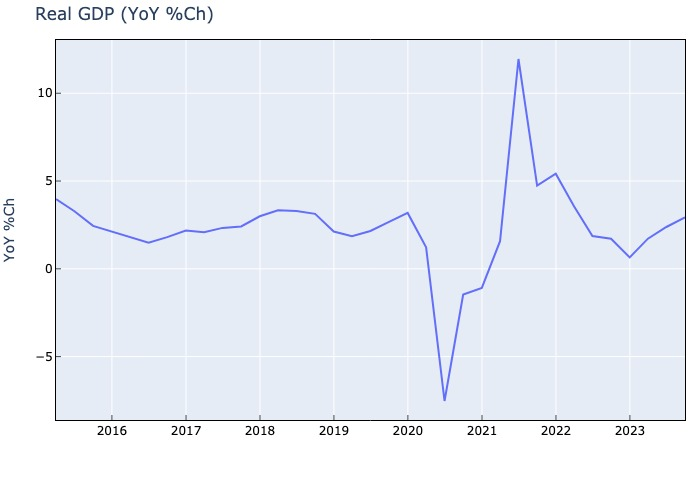

In [16]:
chartbook_panel('GDPC1')


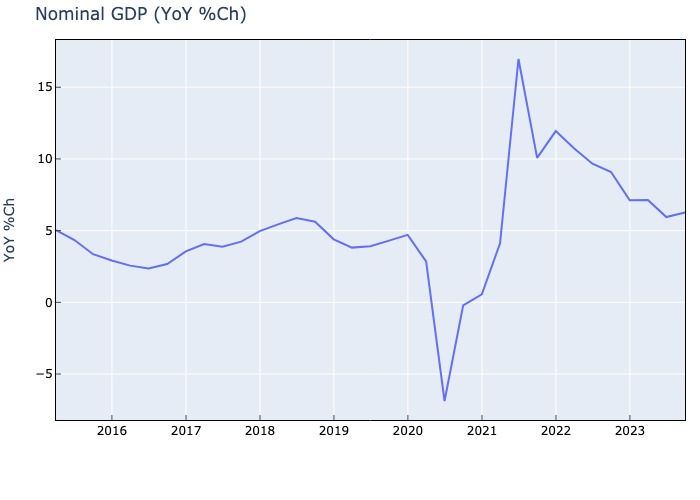

In [17]:
chartbook_panel('GDP')


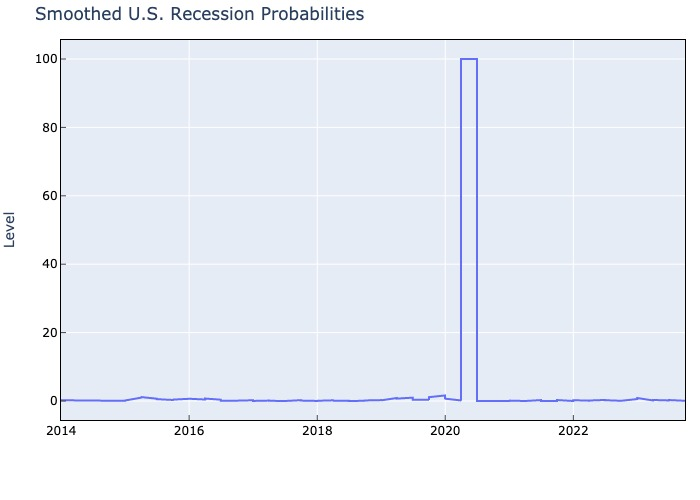

In [18]:
chartbook_panel('RECPROUSM156N')


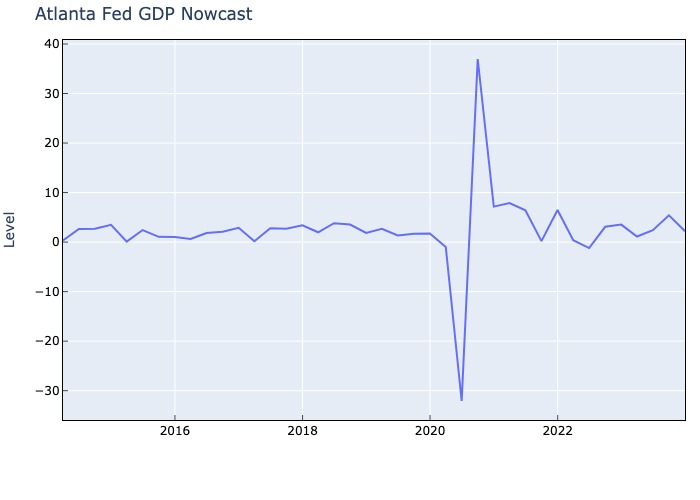

In [19]:
chartbook_panel('GDPNOW')

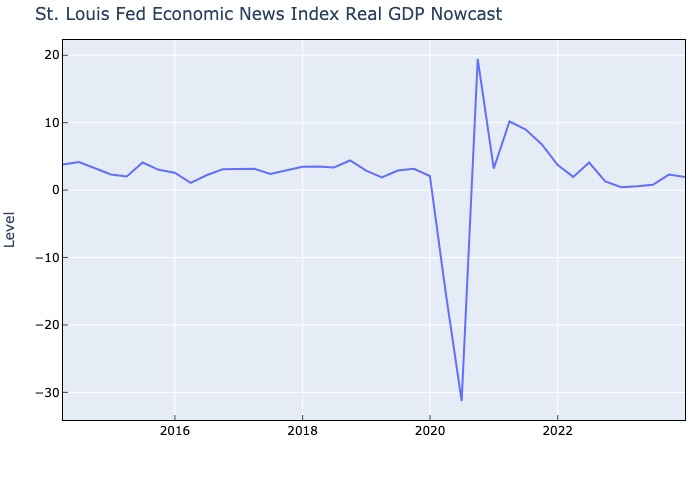

In [20]:
chartbook_panel('STLENI')

# Prices

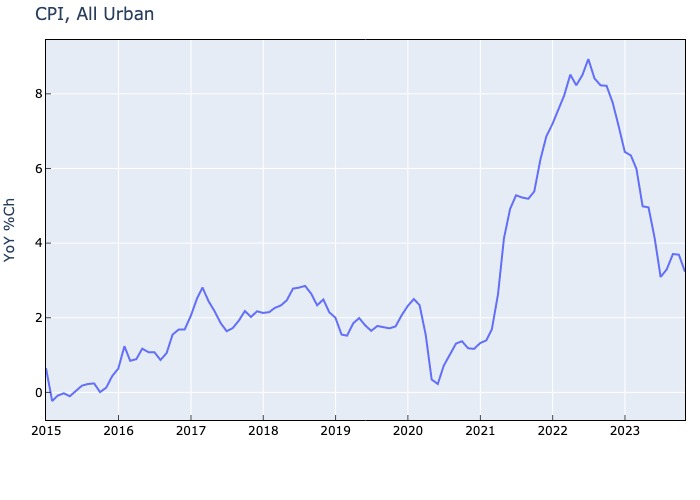

In [21]:
chartbook_panel('CPIAUCSL')


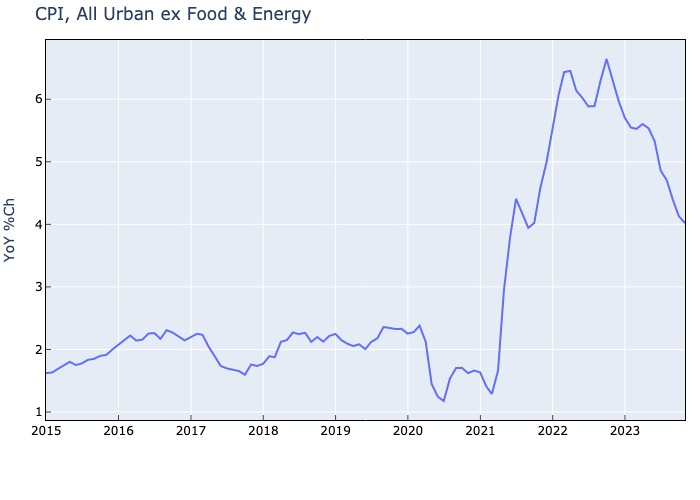

In [22]:
chartbook_panel('CPILFESL')


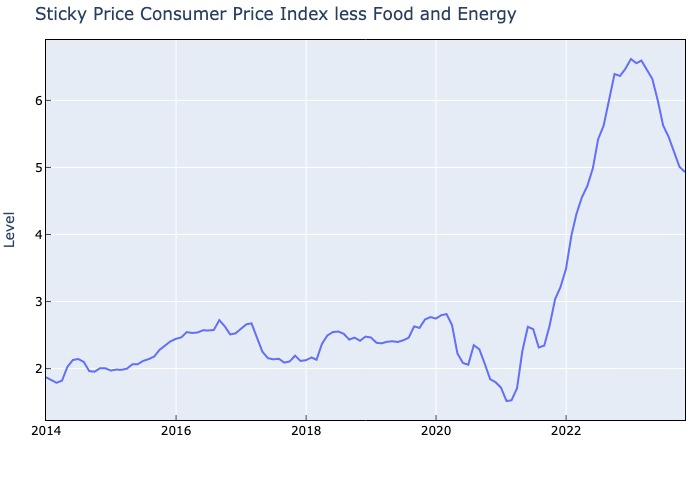

In [23]:
chartbook_panel('CORESTICKM159SFRBATL')


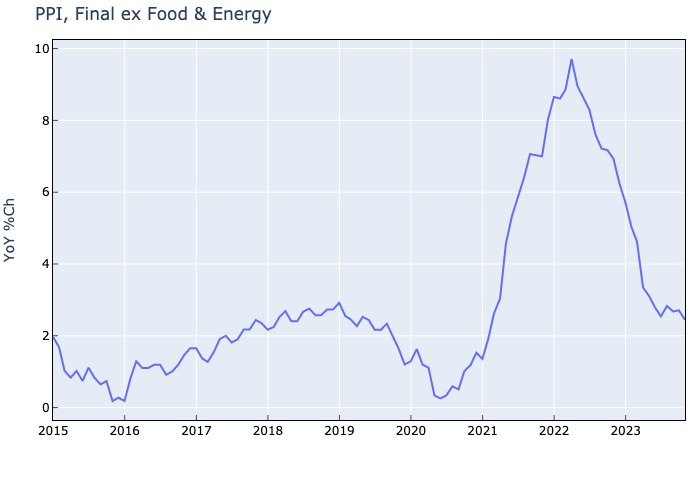

In [24]:
chartbook_panel('PPICOR')


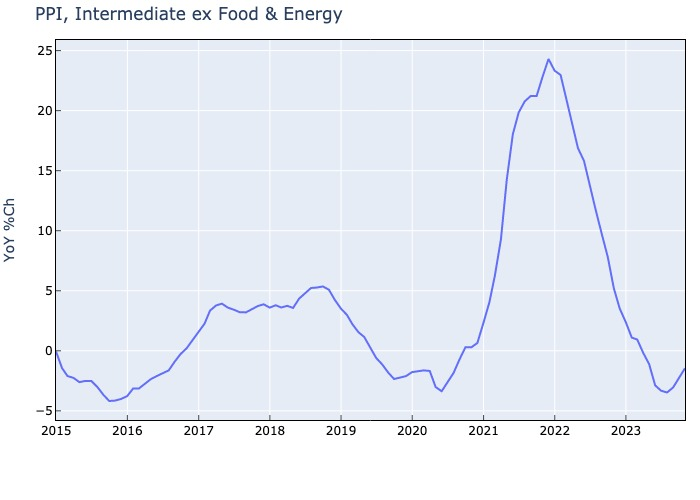

In [25]:
chartbook_panel('WPUID69115')


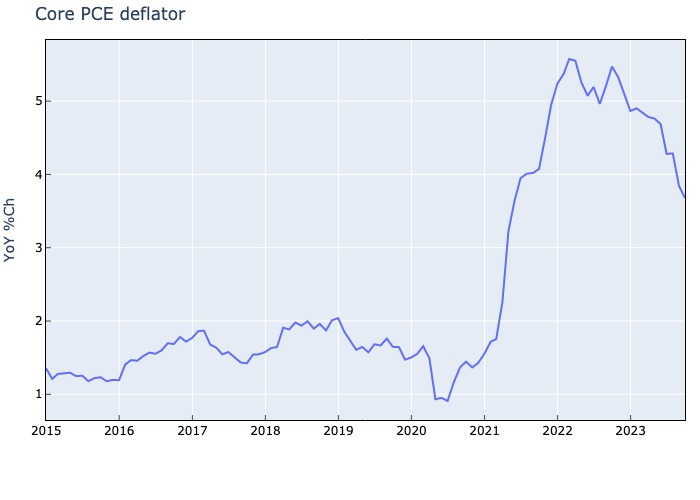

In [26]:
chartbook_panel('PCEPILFE')


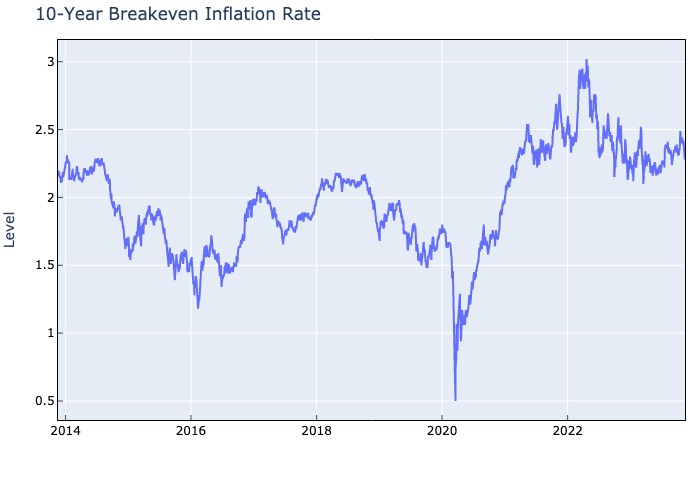

In [27]:
chartbook_panel('T10YIE')


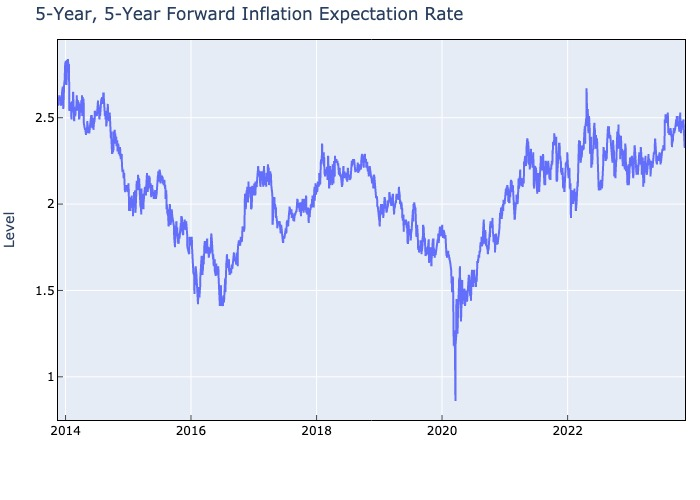

In [28]:
chartbook_panel('T5YIFR')


# Monetary Policy and Rates

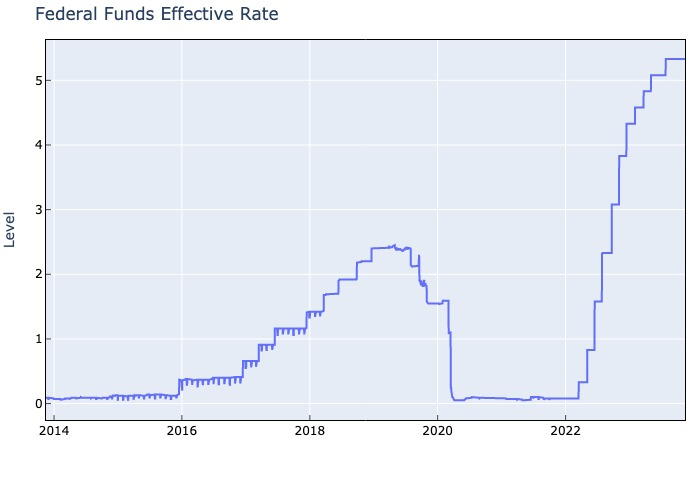

In [29]:
chartbook_panel('DFF')


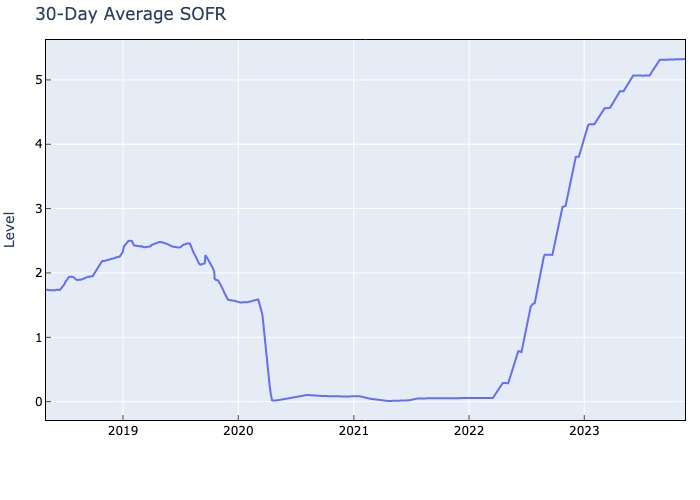

In [30]:
chartbook_panel('SOFR30DAYAVG')


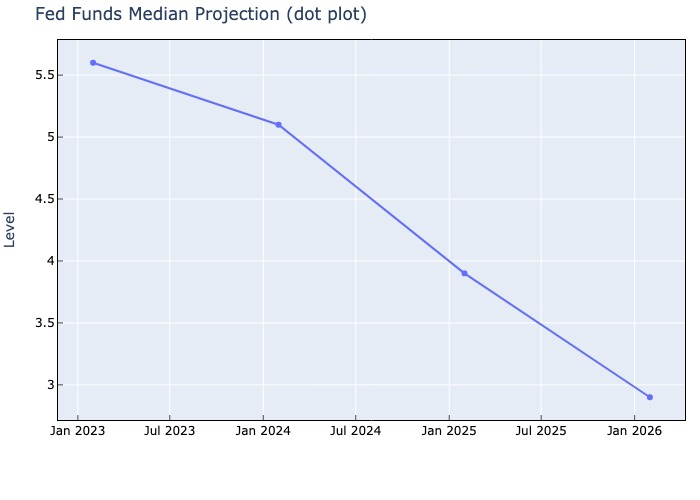

In [31]:
chartbook_panel('FEDTARMD')


In [32]:
# Fed Funds Median Projection (dot plot) None Level

# needs special handling, chart through 2025
# indicator = 'FEDTARMD'

# indicator_params = INDICATORS[indicator]
# indicator_params['df'] = macro_indicators[indicator]

# chart_params = do_transform(**indicator_params)
# yoy_m(**chart_params)


In [33]:
ychistory = macro_indicators['USTREASURY_YIELD']
ycdf_last = ychistory.index[-1]

ycdf_1y = ycdf_last - pd.offsets.DateOffset(years=1) + pd.offsets.Day() - pd.offsets.BDay()
if not ycdf_1y in ychistory.index:
    ycdf_1y += pd.offsets.BDay()
    
ycdf_3m = ycdf_last - pd.offsets.DateOffset(months=3) + pd.offsets.Day() - pd.offsets.BDay()
if not ycdf_3m in ychistory.index:
    ycdf_3m += pd.offsets.BDay()

ycdf_1m = ycdf_last - pd.offsets.DateOffset(months=1) + pd.offsets.Day() - pd.offsets.BDay()
if not ycdf_1m in ychistory.index:
    ycdf_1m += pd.offsets.BDay()
    
ycdf_1w = ycdf_last - pd.offsets.DateOffset(weeks=1) + pd.offsets.Day() - pd.offsets.BDay()
if not ycdf_1w in ychistory.index:
    ycdf_1w += pd.offsets.BDay()

ycdf = ychistory.loc[ychistory.index==ycdf_last] \
    .transpose()
ycdf.columns = ['YIELDCURVE']

tempdf = ychistory.loc[ychistory.index==ycdf_1y] \
    .transpose()
tempdf.columns = ['1Y']
ycdf['1Y'] = tempdf['1Y'].tolist()

tempdf = ychistory.loc[ychistory.index==ycdf_3m] \
    .transpose()
tempdf.columns = ['3M']
ycdf['3M'] = tempdf['3M'].tolist()

tempdf = ychistory.loc[ychistory.index==ycdf_1m] \
    .transpose()
tempdf.columns = ['1M']
ycdf['1M'] = tempdf['1M'].tolist()

tempdf = ychistory.loc[ychistory.index==ycdf_1w] \
    .transpose()
tempdf.columns = ['1W']
ycdf['1W'] = tempdf['1W'].tolist()

ycdf['X'] = [1/12, 2/12, 3/12, 6/12, 1, 2, 3, 5, 7, 10, 20, 30]
ycdf=ycdf.set_index('X')

ycdf

col = 'YIELDCURVE'
title = 'Yield Curve'
xaxis_title = 'Term'
yaxis_title = 'Yield'
fig = go.Figure(
    data=[go.Scatter(y=ycdf[col],
                     x=ycdf.index.to_list(),
                     name="latest",
                     line_width=2,
                     # color_discrete_sequence=plotly.colors.qualitative.Dark24
                    ),
#           go.Scatter(y=ycdf['3M'],
#                      x=ycdf.index.to_list(),
#                      name="3 months ago",
#                      line_width=2,
#                      # color_discrete_sequence=plotly.colors.qualitative.Dark24
#                     ),
#           go.Scatter(y=ycdf['1M'],
#                      x=ycdf.index.to_list(),
#                      name="1 month ago",
#                      line_width=2,
#                      # color_discrete_sequence=plotly.colors.qualitative.Dark24
#                     ),
          go.Scatter(y=ycdf['1W'],
                     x=ycdf.index.to_list(),
                     name="1 week ago",
                     line_width=2,
                     # color_discrete_sequence=plotly.colors.qualitative.Dark24
                    ),
          go.Scatter(y=ycdf['1Y'],
                     x=ycdf.index.to_list(),
                     name="1 year ago",
                     line_width=2,
                     # color_discrete_sequence=plotly.colors.qualitative.Dark24
                    ),          
         ],
    layout=generic_layout)

fig.update_layout(dict(title=title,
                       xaxis_title=xaxis_title,
                       yaxis_title=yaxis_title,
                      ))

fig

In [123]:
fig.write_image("images/%s.png" % col,format='png',engine='kaleido')
Image.open("images/%s.png" % col).convert('RGB')


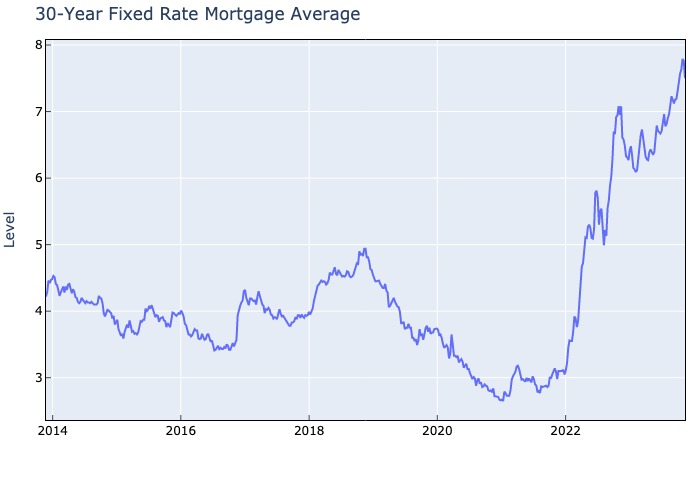

In [35]:
chartbook_panel('MORTGAGE30US')


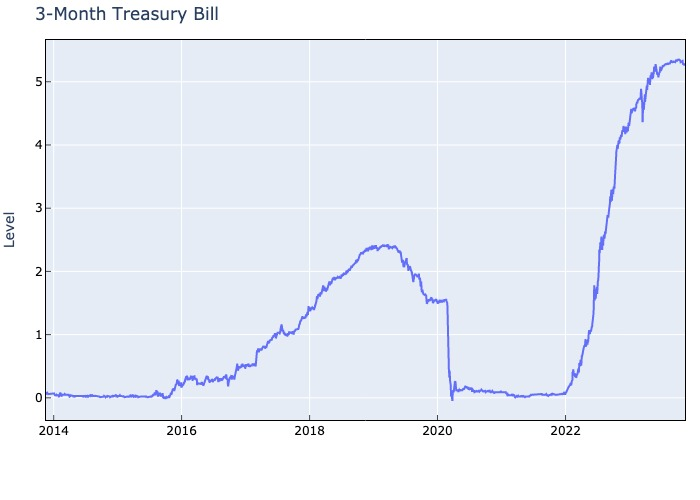

In [36]:
chartbook_panel('DTB3')


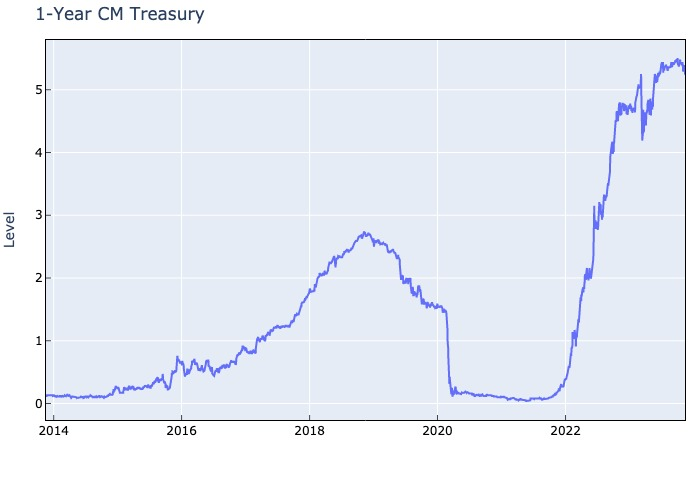

In [37]:
chartbook_panel('DGS1')


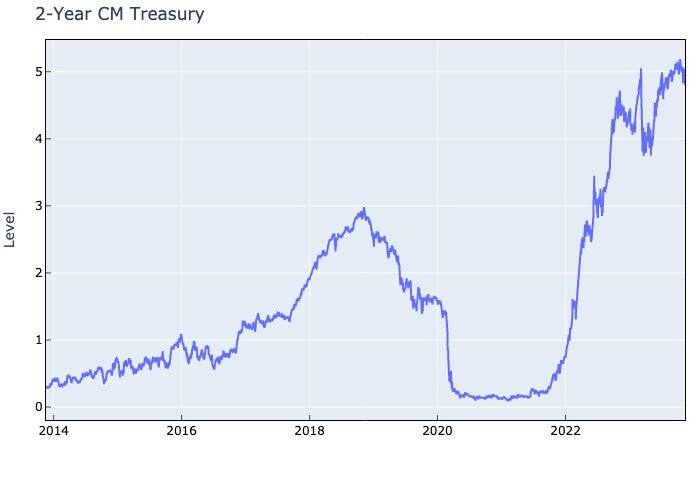

In [38]:
chartbook_panel('DGS2')


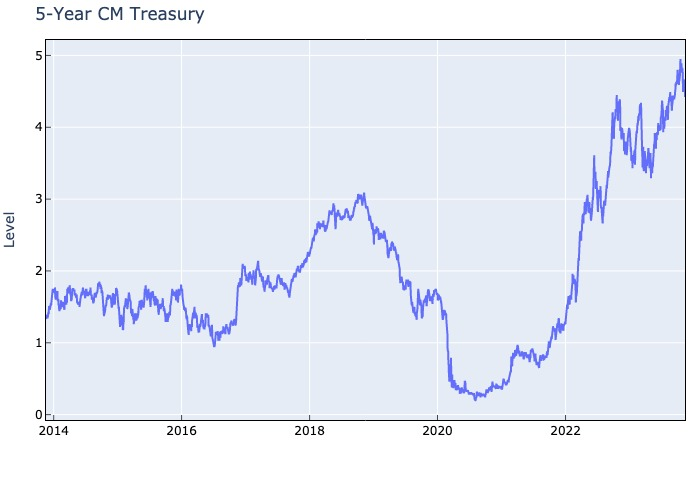

In [39]:
chartbook_panel('DGS5')


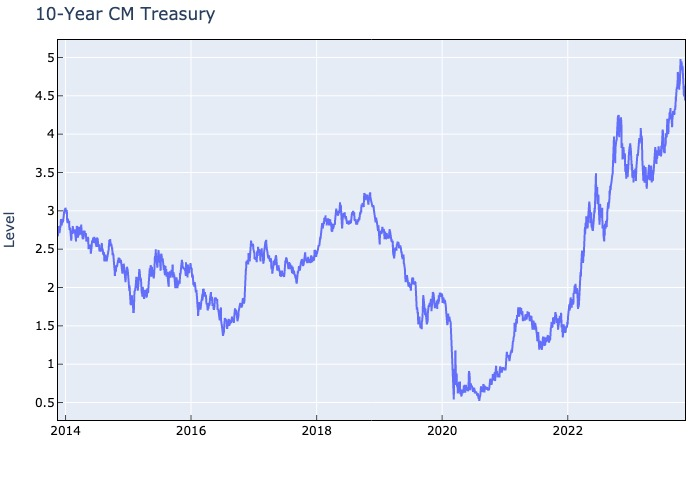

In [40]:
chartbook_panel('DGS10')


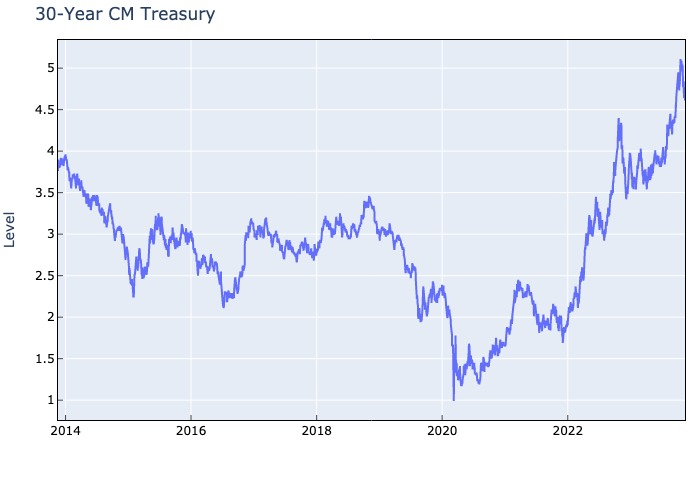

In [41]:
chartbook_panel('DGS30')


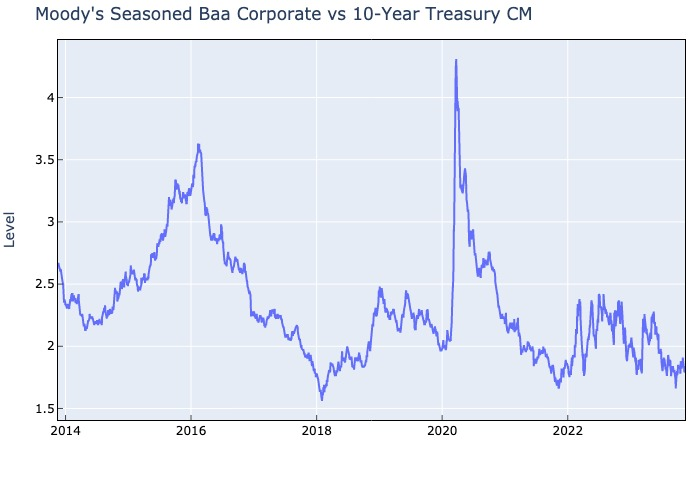

In [42]:
chartbook_panel('BAA10Y')


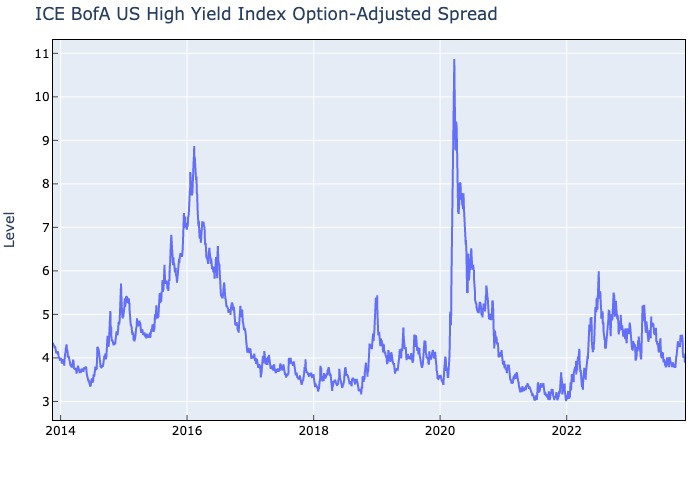

In [43]:
chartbook_panel('BAMLH0A0HYM2')


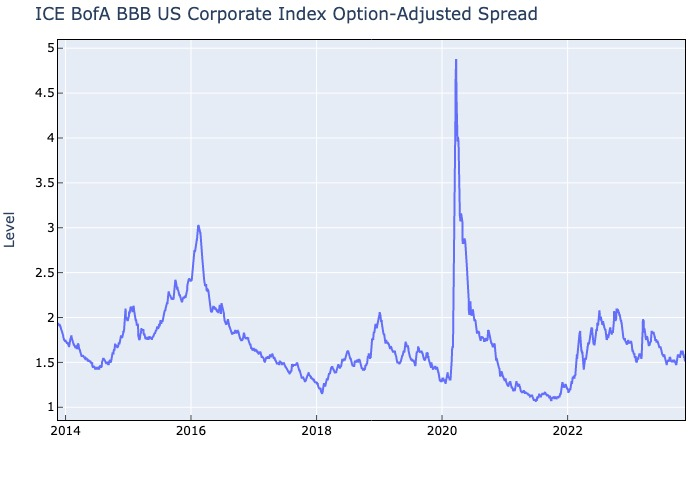

In [44]:
chartbook_panel('BAMLC0A4CBBB')


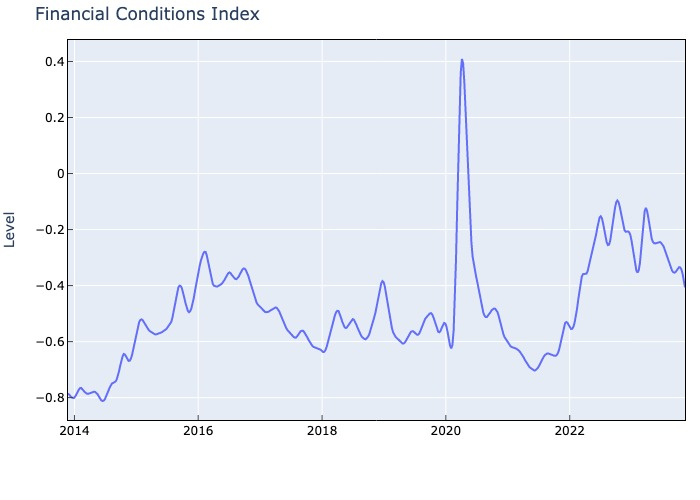

In [45]:
chartbook_panel('NFCI')


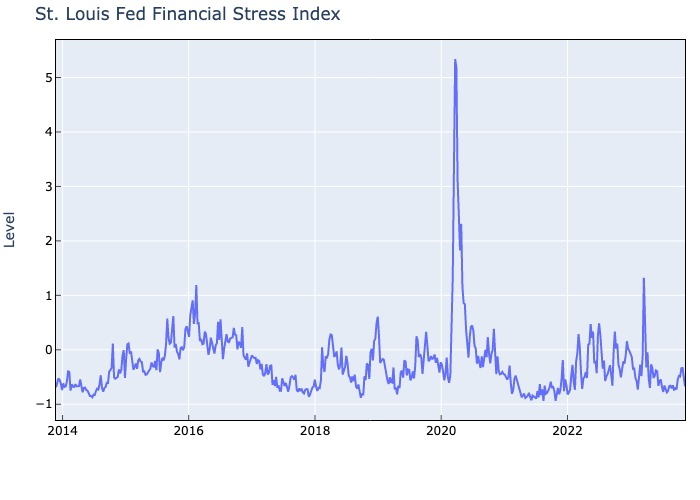

In [46]:
chartbook_panel('STLFSI4')


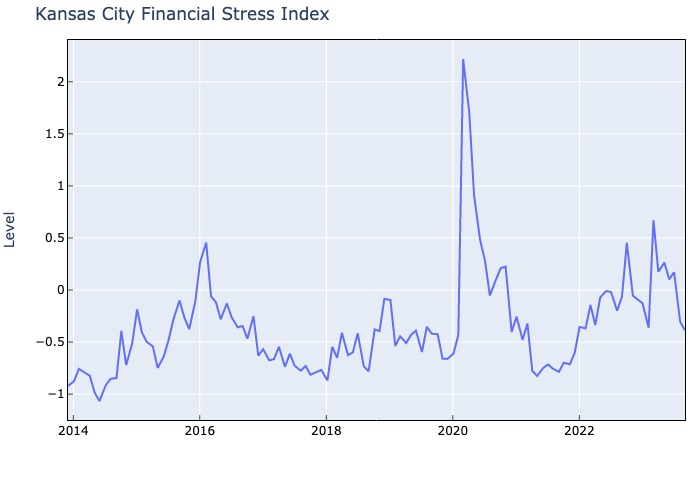

In [47]:
chartbook_panel('KCFSI')


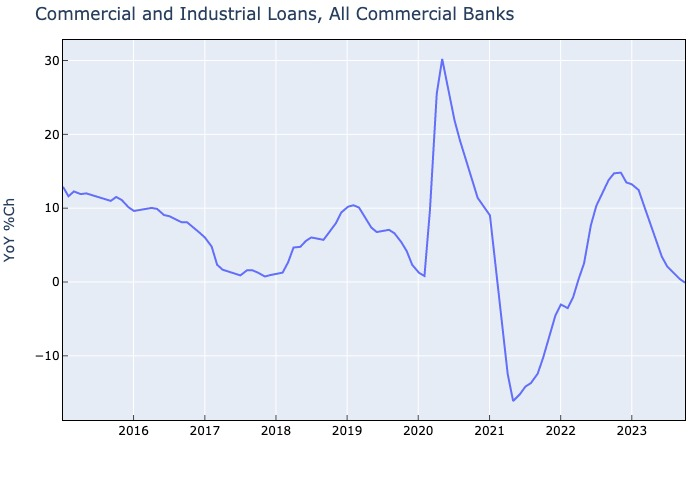

In [48]:
chartbook_panel('BUSLOANS')


# Labor Markets


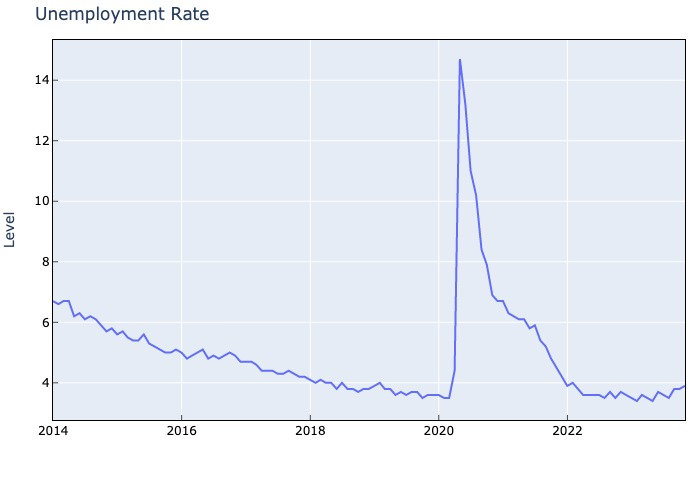

In [49]:
chartbook_panel('UNRATE')


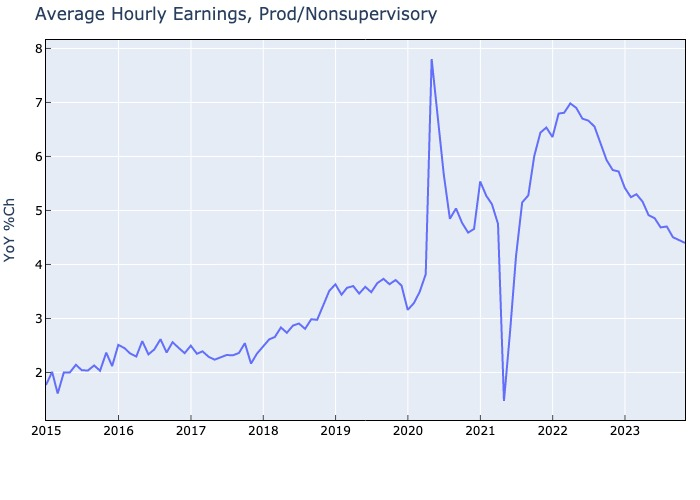

In [50]:
chartbook_panel('AHETPI')

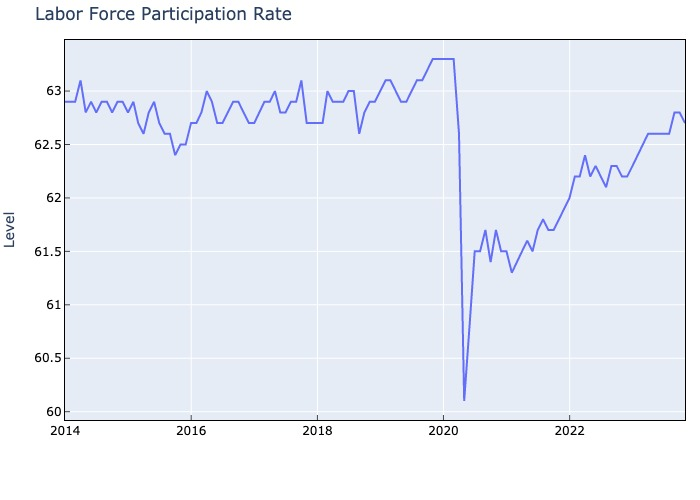

In [51]:
chartbook_panel('CIVPART')


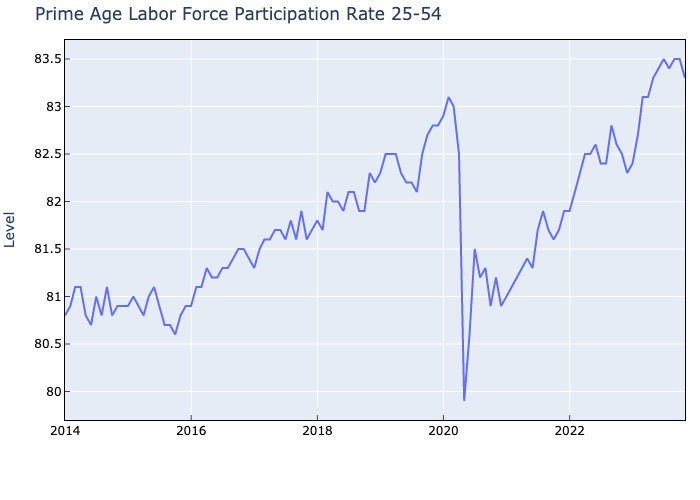

In [52]:
chartbook_panel('LNS11300060')


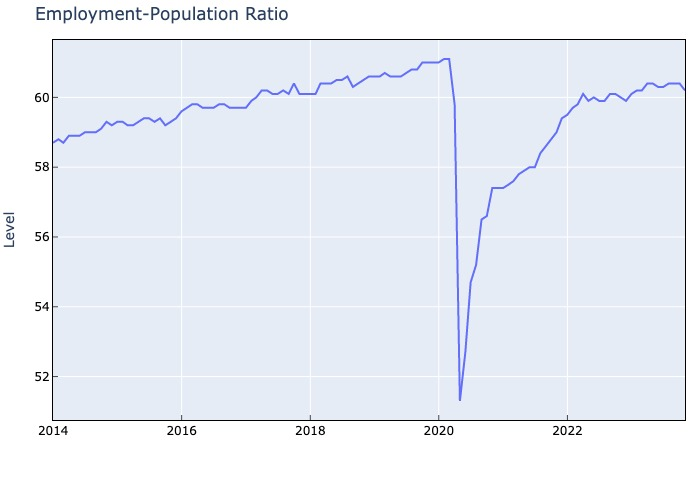

In [53]:
chartbook_panel('EMRATIO')


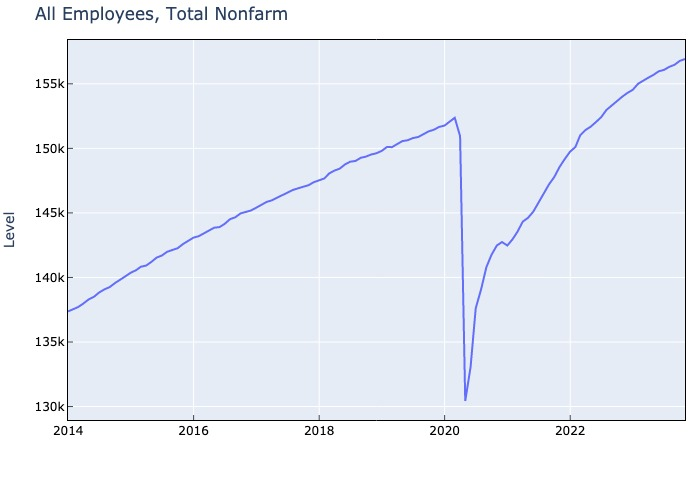

In [54]:
chartbook_panel('PAYEMS')


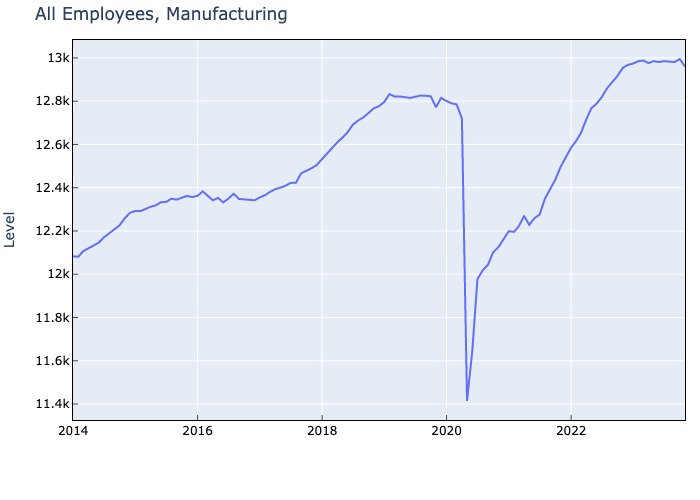

In [55]:
chartbook_panel('MANEMP')


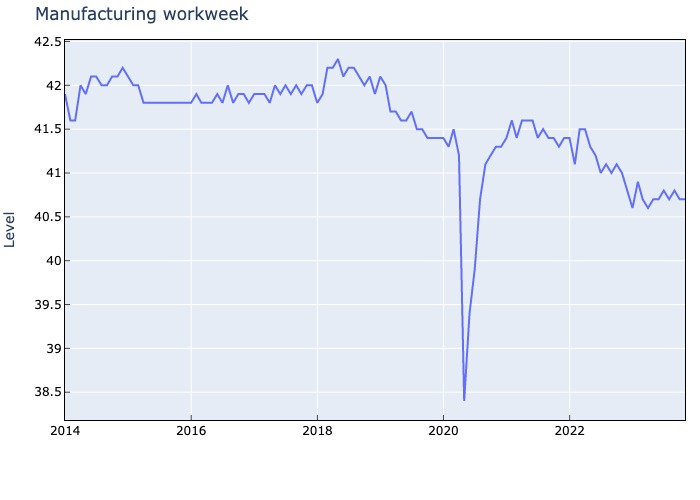

In [56]:
chartbook_panel('AWHMAN')


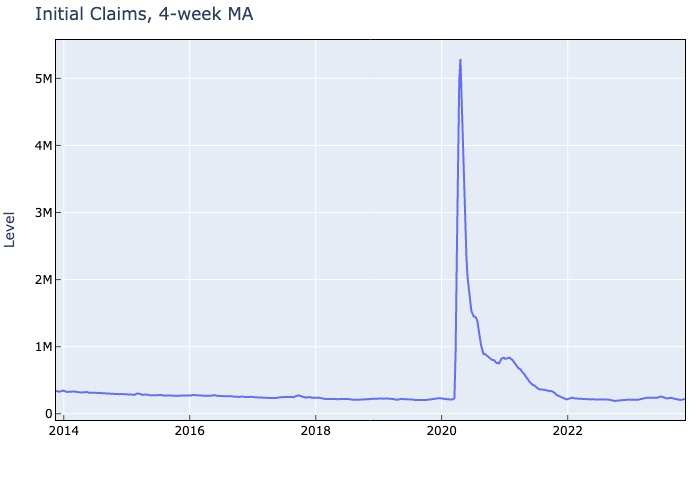

In [57]:
chartbook_panel('IC4WSA')


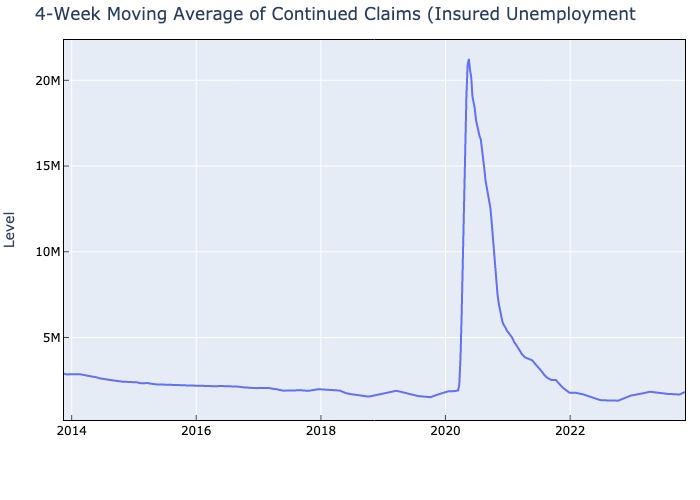

In [58]:
chartbook_panel('CC4WSA')


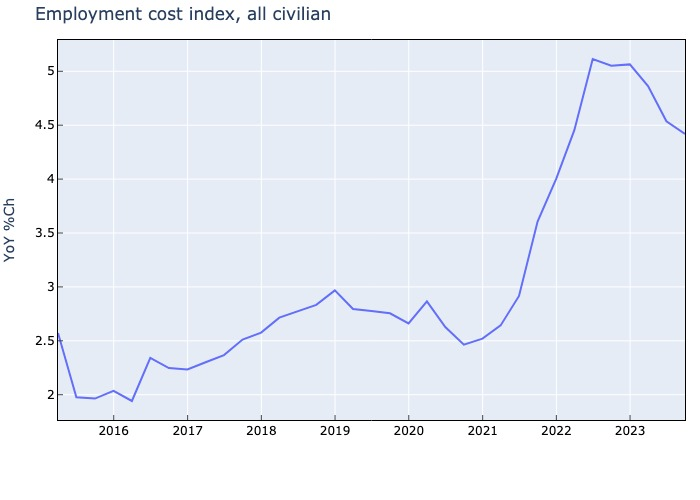

In [59]:
chartbook_panel('ECIALLCIV')


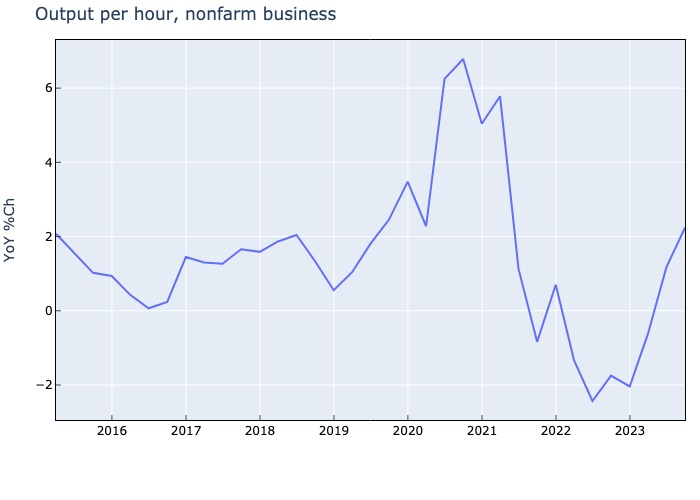

In [60]:
chartbook_panel('OPHNFB')


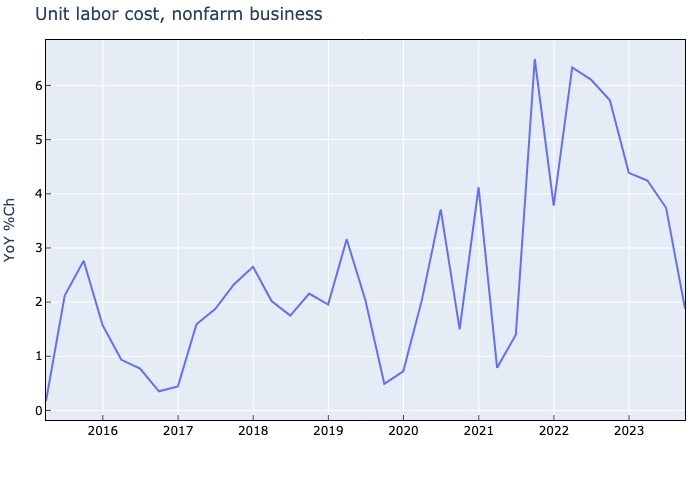

In [61]:
chartbook_panel('ULCNFB')


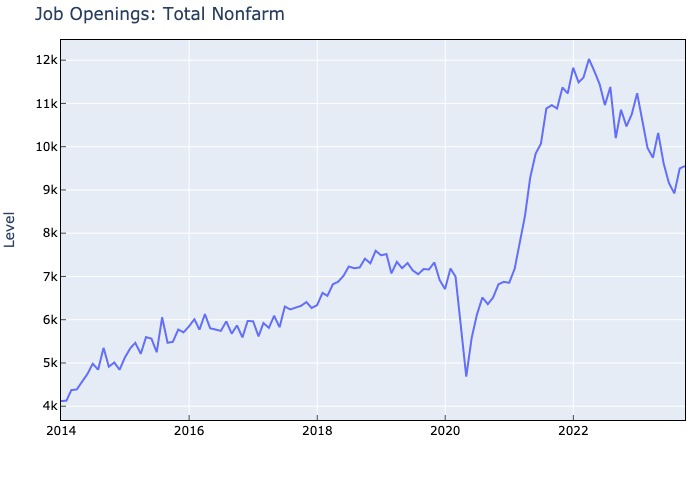

In [62]:
chartbook_panel('JTSJOL')


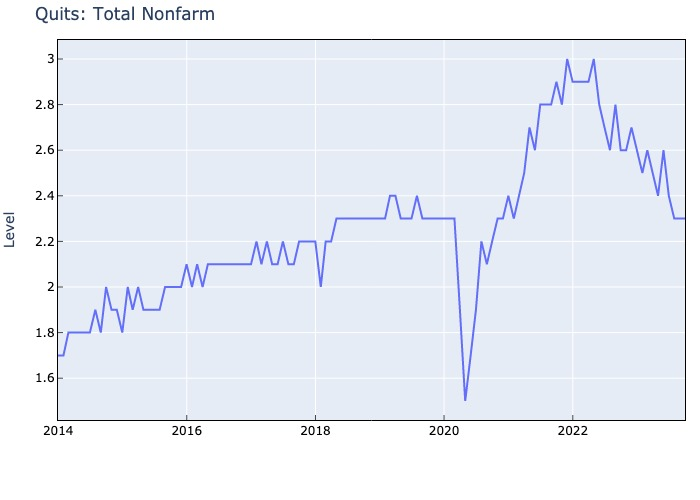

In [63]:
chartbook_panel('JTSQUR')


# Personal Income and Consumption

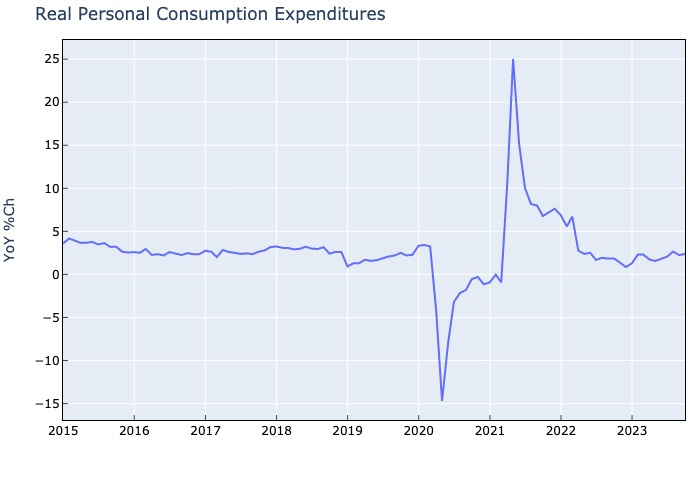

In [64]:
chartbook_panel('PCEC96')


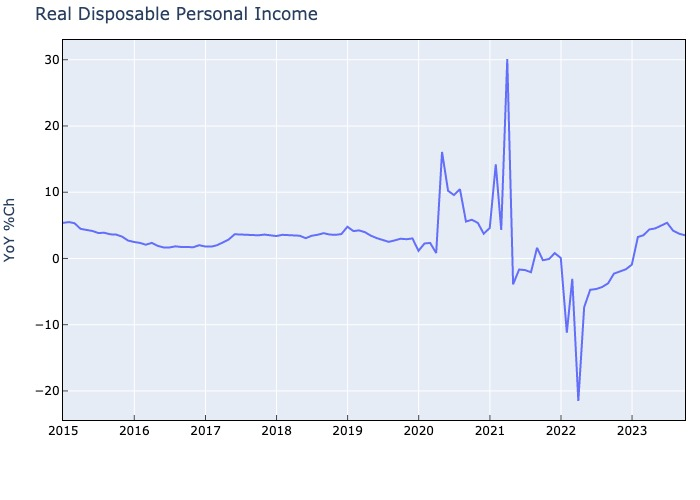

In [65]:
chartbook_panel('DSPIC96')


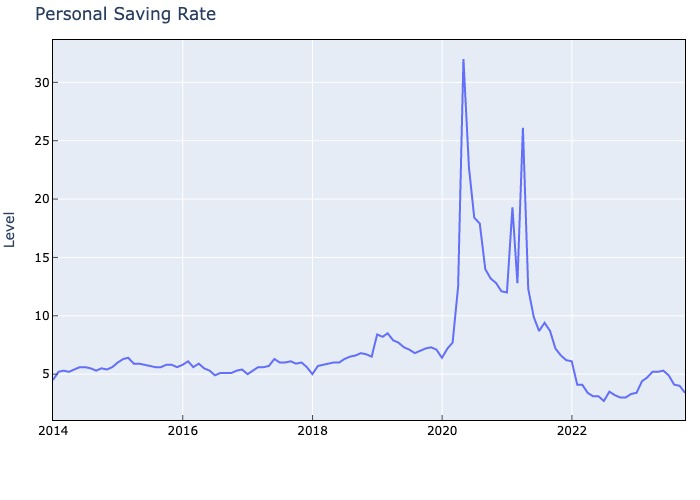

In [66]:
chartbook_panel('PSAVERT')


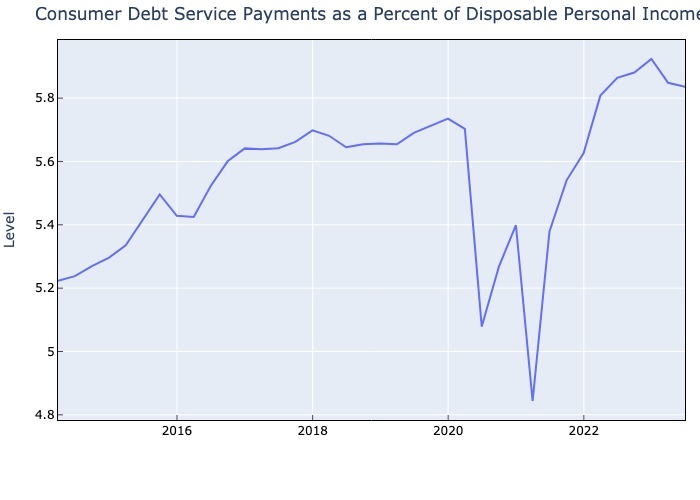

In [67]:
chartbook_panel('CDSP')


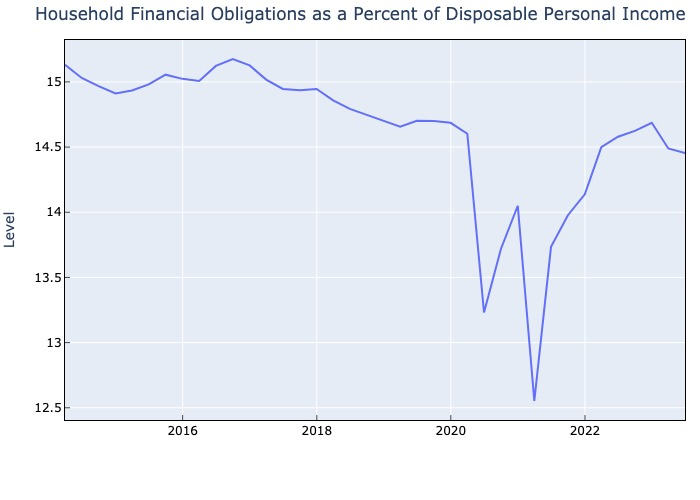

In [68]:
chartbook_panel('FODSP')


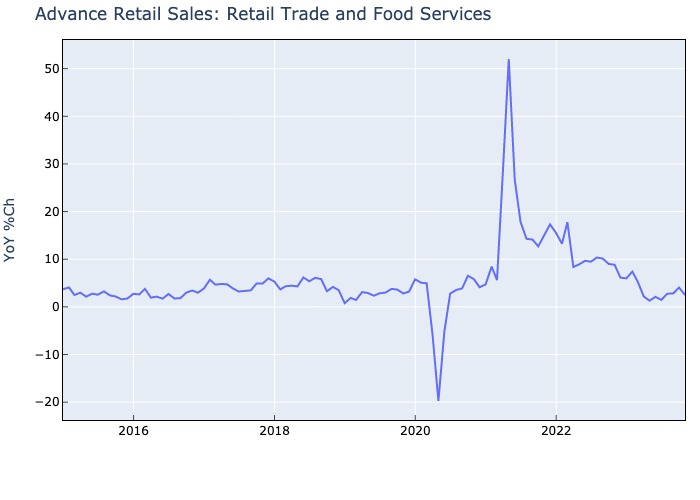

In [69]:
chartbook_panel('RSAFS')


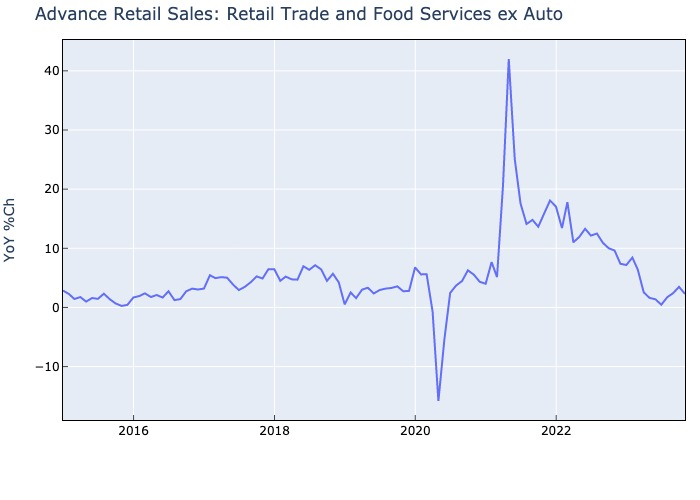

In [70]:
chartbook_panel('RSFSXMV')


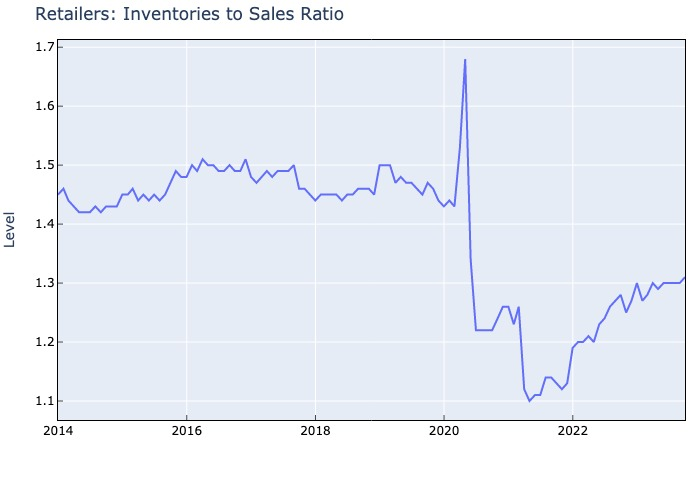

In [71]:
chartbook_panel('RETAILIRSA')


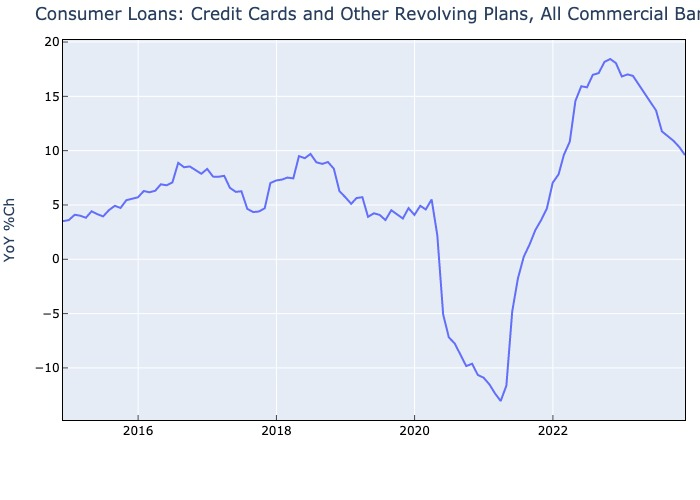

In [72]:
chartbook_panel('CCLACBW027SBOG')


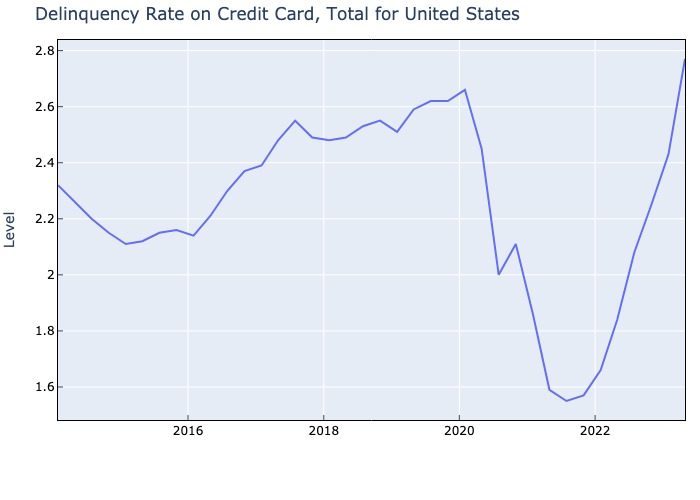

In [73]:
chartbook_panel('DRCCLACBS')

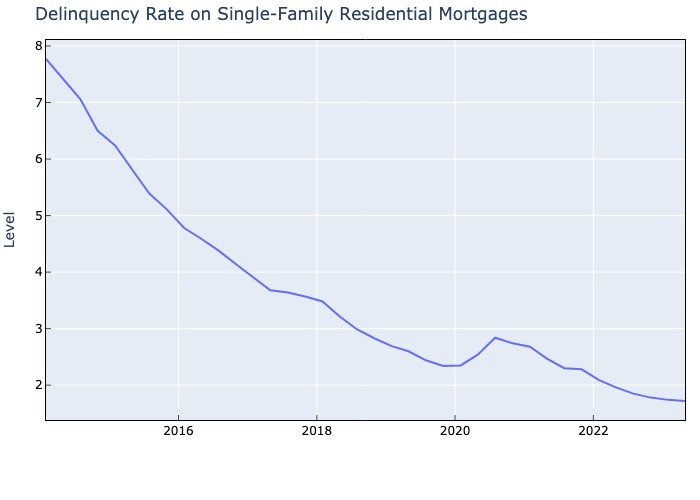

In [74]:
chartbook_panel('DRSFRMACBS')

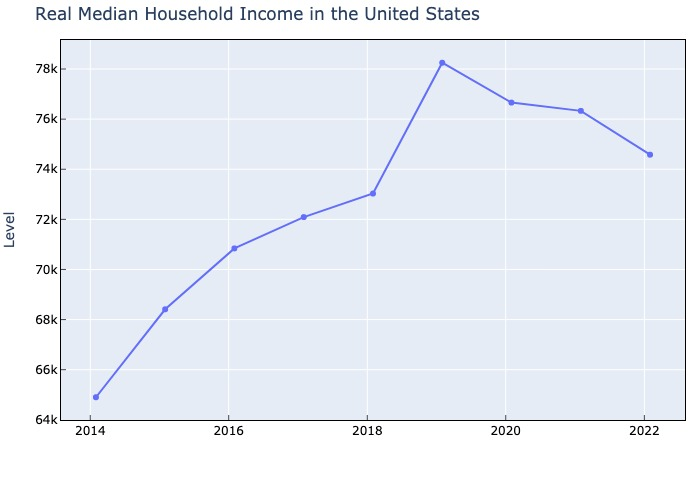

In [75]:
chartbook_panel('MEHOINUSA672N')

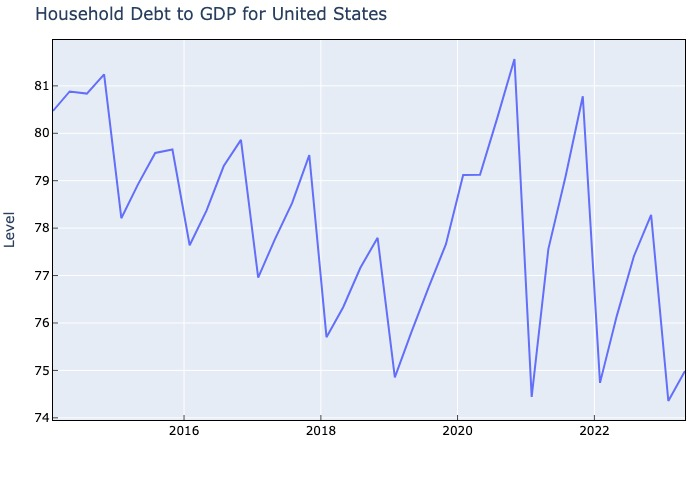

In [76]:
chartbook_panel('HDTGPDUSQ163N')

# Housing

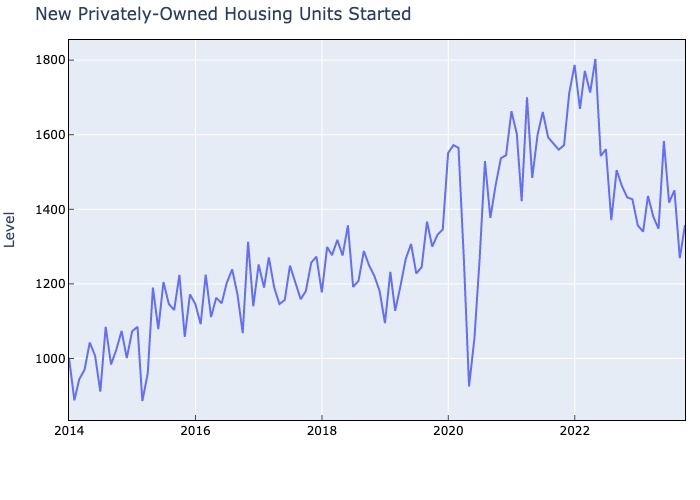

In [77]:
chartbook_panel('HOUST')

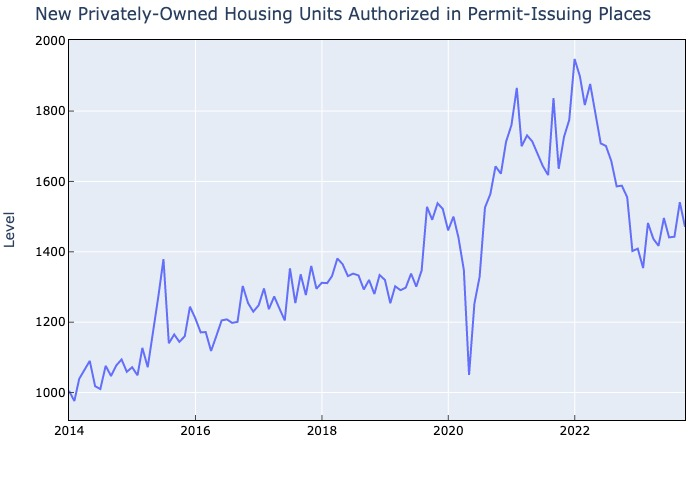

In [78]:
chartbook_panel('PERMIT')

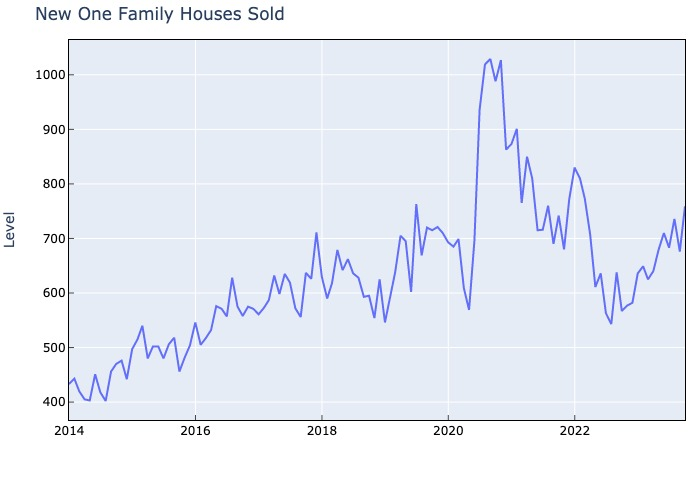

In [79]:
chartbook_panel('HSN1F')

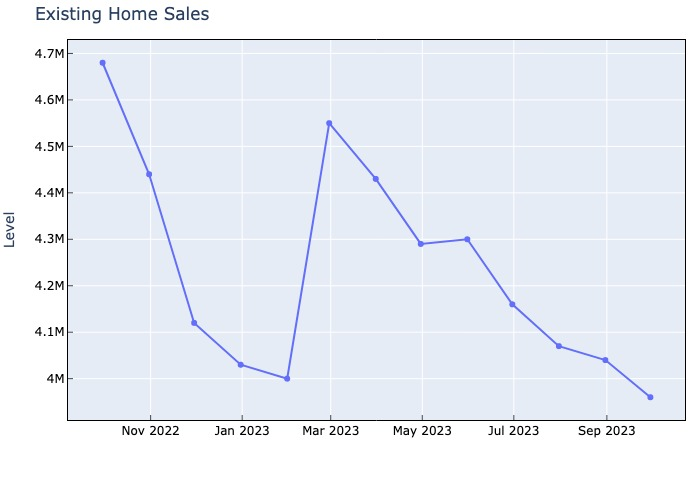

In [80]:
chartbook_panel('EXHOSLUSM495S')

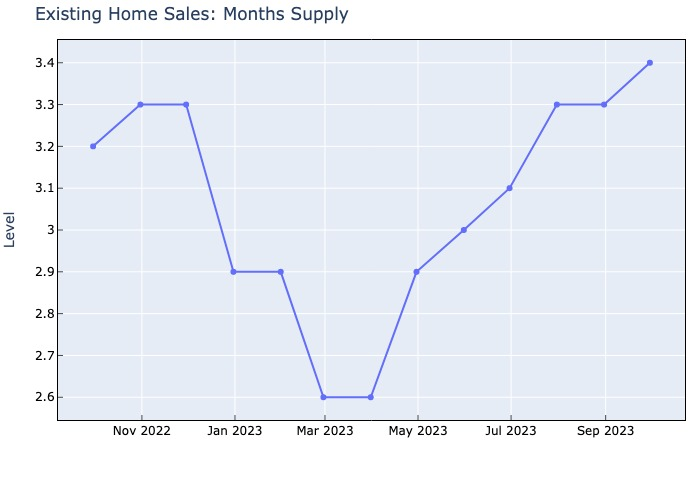

In [81]:
chartbook_panel('HOSSUPUSM673N')

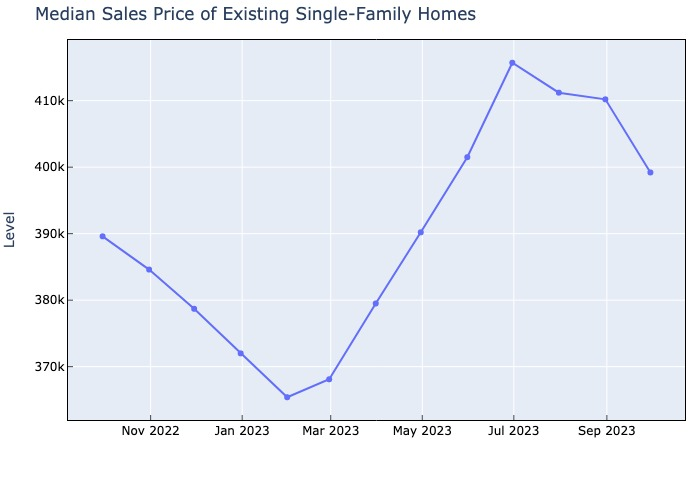

In [82]:
chartbook_panel('HSFMEDUSM052N')

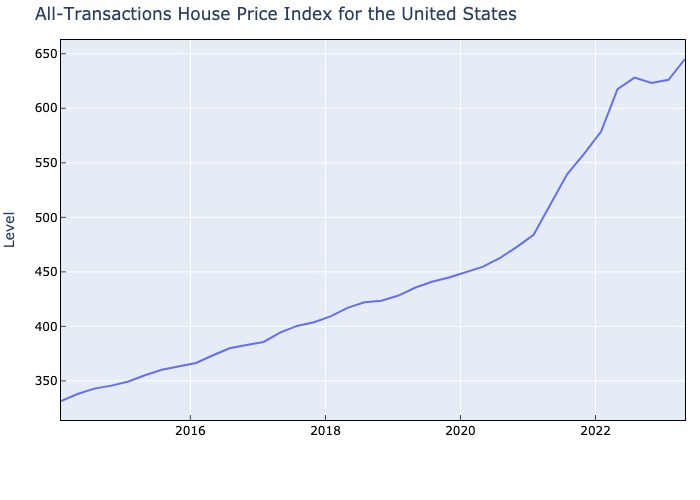

In [83]:
chartbook_panel('USSTHPI')

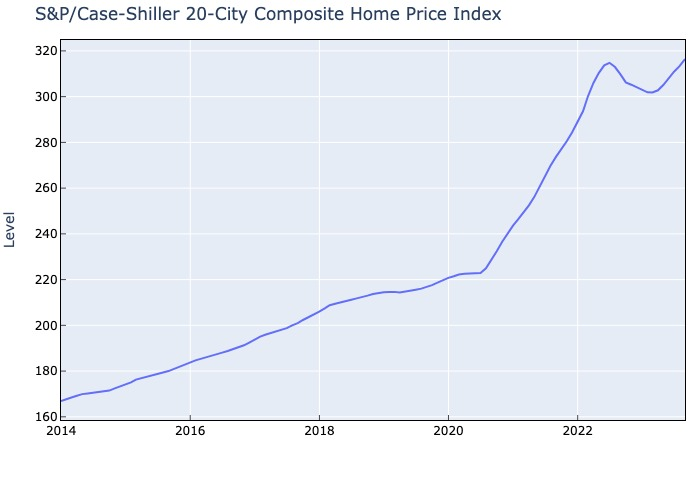

In [84]:
chartbook_panel('SPCS20RSA')

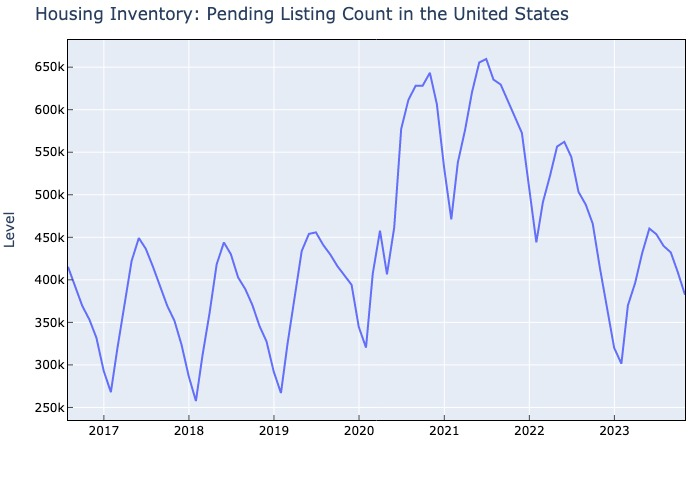

In [85]:
chartbook_panel('PENLISCOUUS')

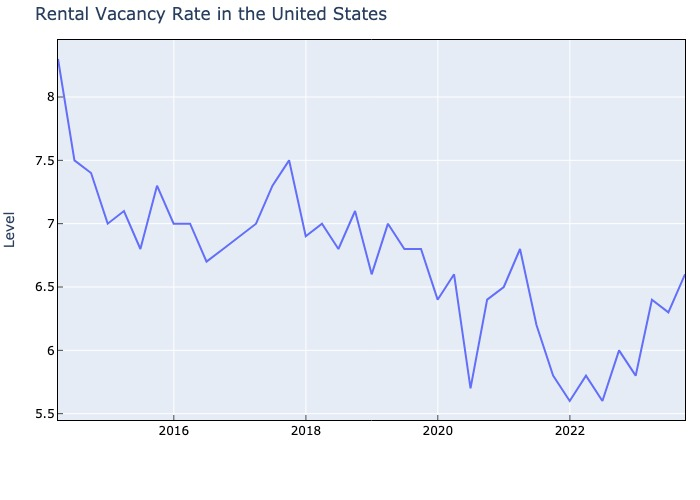

In [86]:
chartbook_panel('RRVRUSQ156N')

# Manufacturing

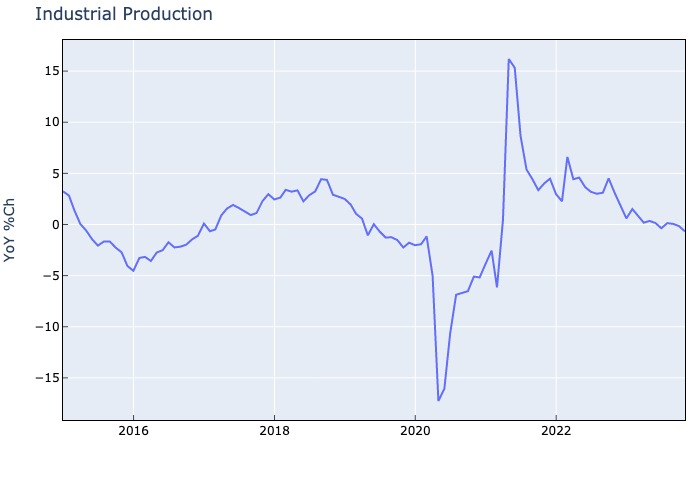

In [87]:
chartbook_panel('INDPRO')

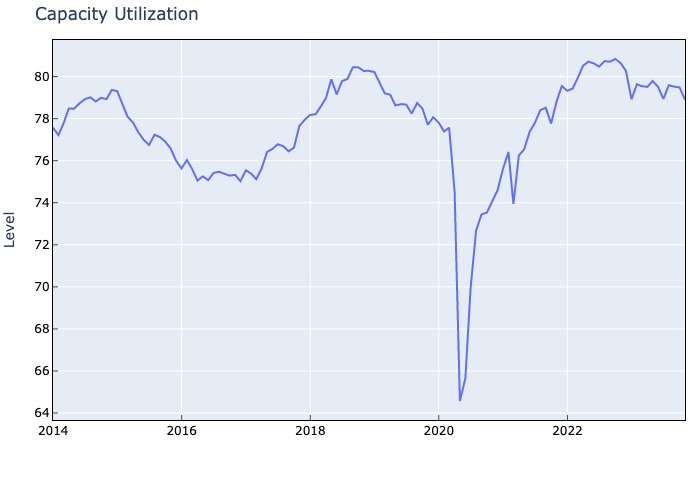

In [88]:
chartbook_panel('TCU')

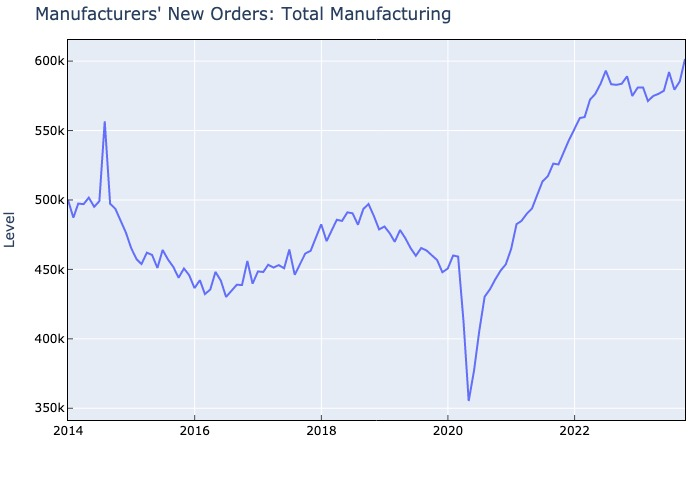

In [89]:
chartbook_panel('AMTMNO')

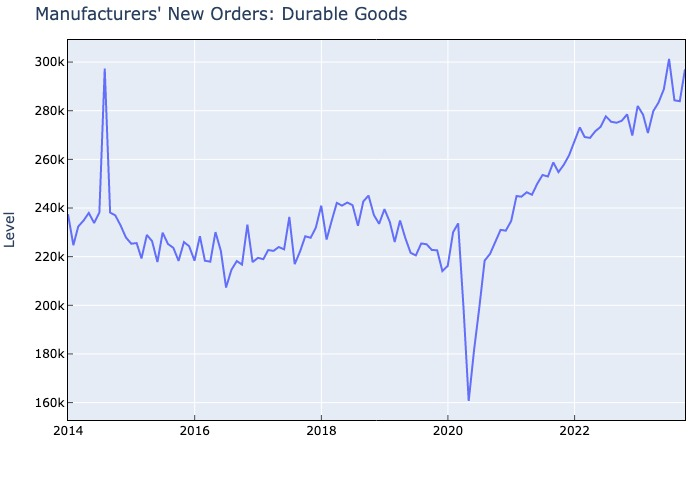

In [90]:
chartbook_panel('DGORDER')

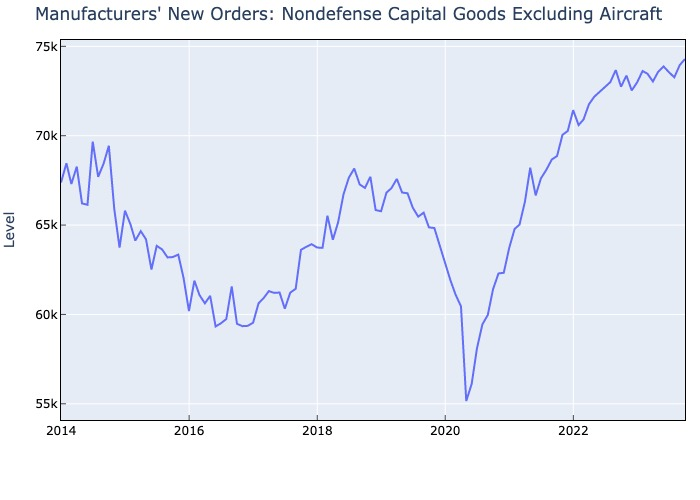

In [91]:
chartbook_panel('NEWORDER')

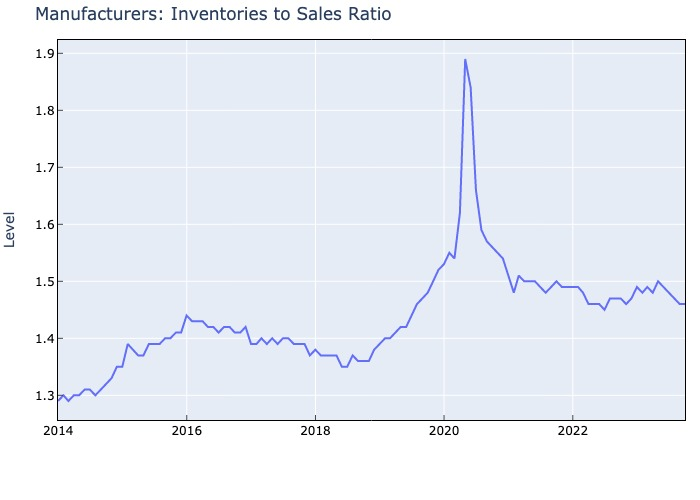

In [92]:
chartbook_panel('MNFCTRIRSA')

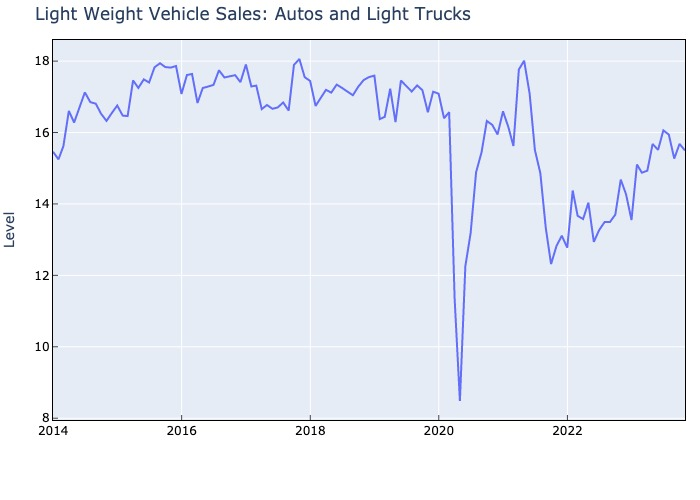

In [93]:
chartbook_panel('ALTSALES')

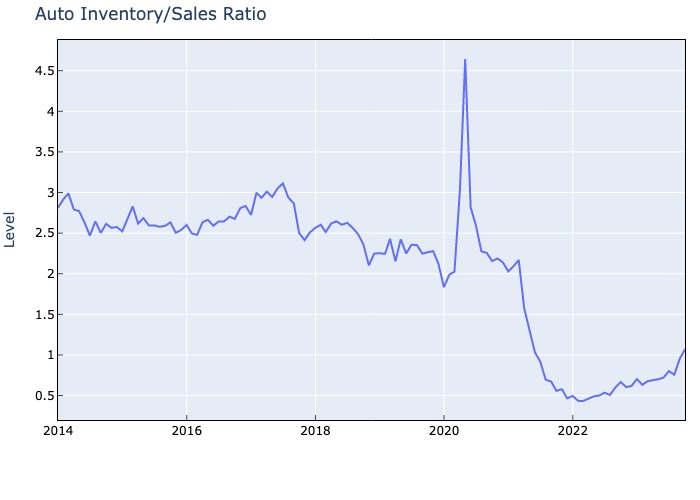

In [94]:
chartbook_panel('AISRSA')

# Government


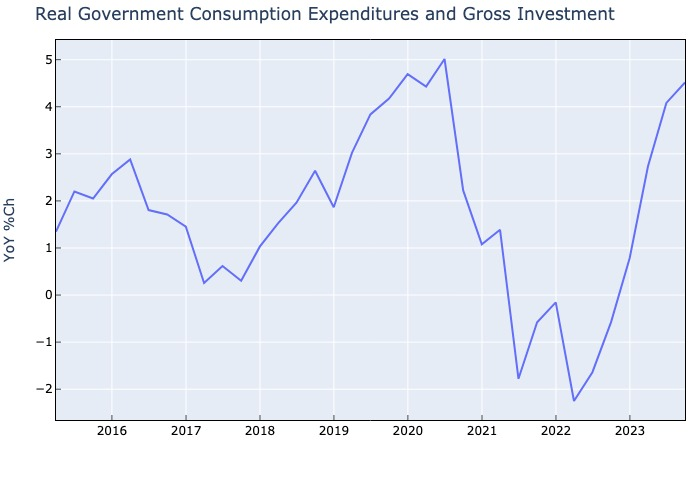

In [95]:
chartbook_panel('GCEC1')

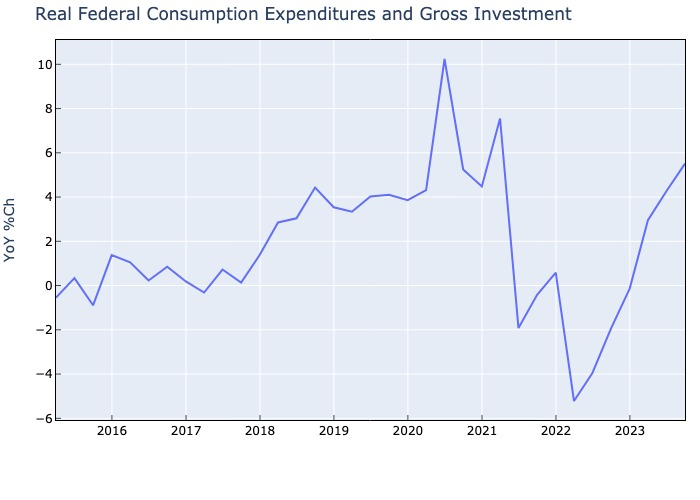

In [96]:
chartbook_panel('FGCEC1')

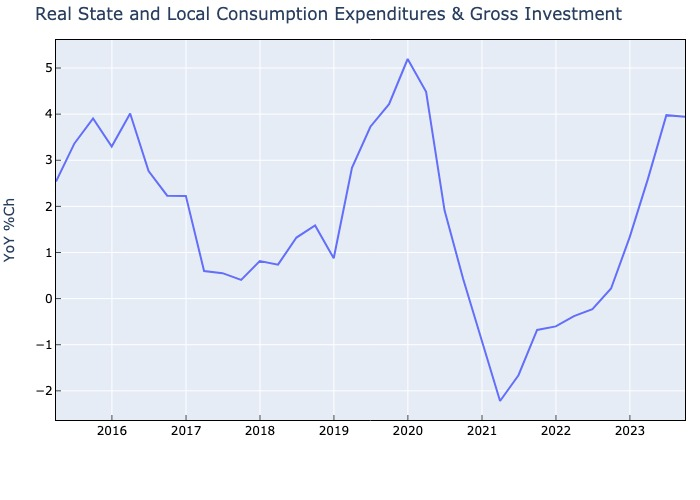

In [97]:
chartbook_panel('SLCEC1')


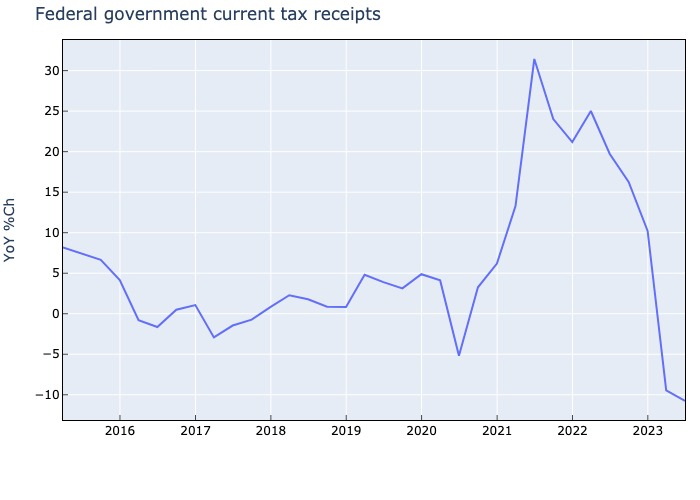

In [98]:
chartbook_panel('W006RC1Q027SBEA')

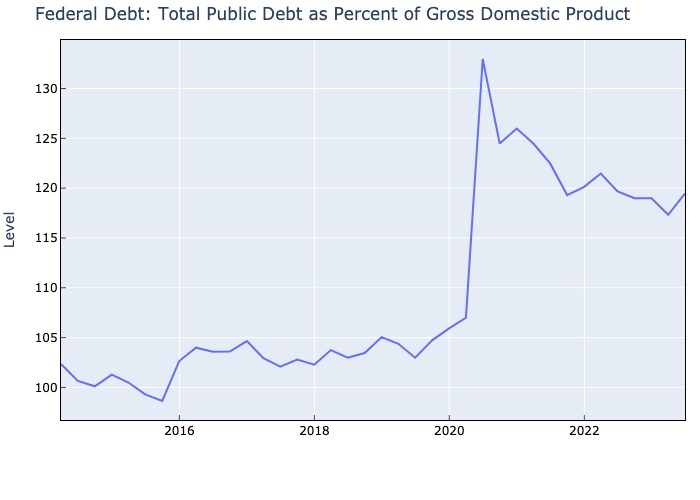

In [99]:
chartbook_panel('GFDEGDQ188S')

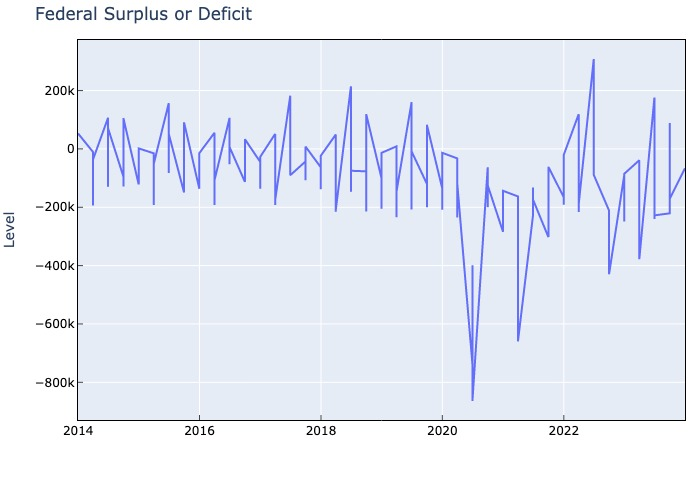

In [100]:
chartbook_panel('MTSDS133FMS')

# External


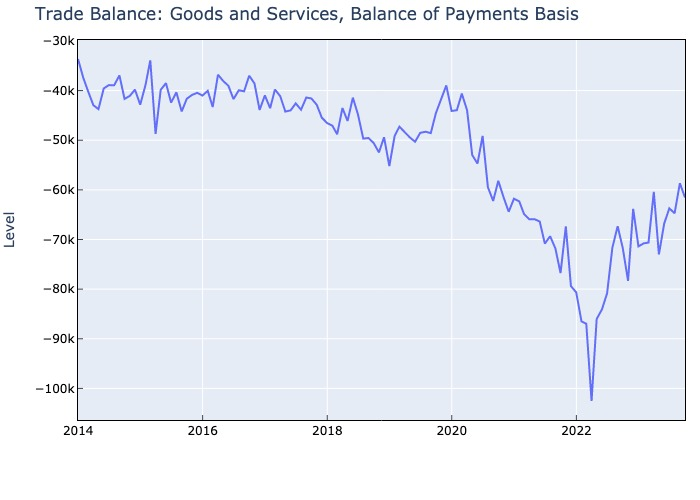

In [101]:
chartbook_panel('BOPGSTB')

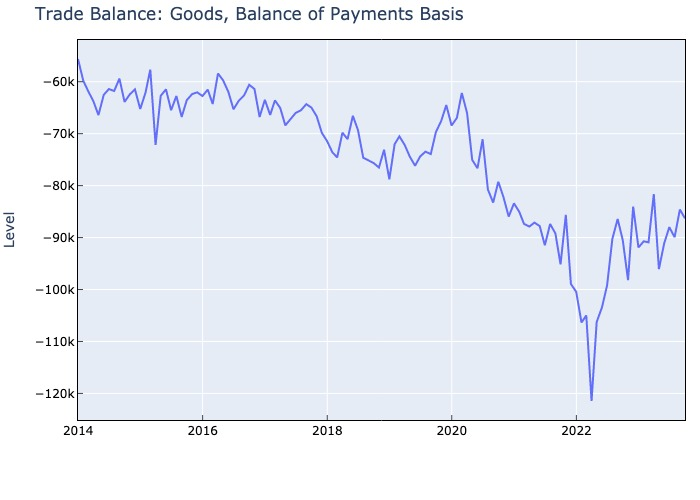

In [102]:
chartbook_panel('BOPGTB')

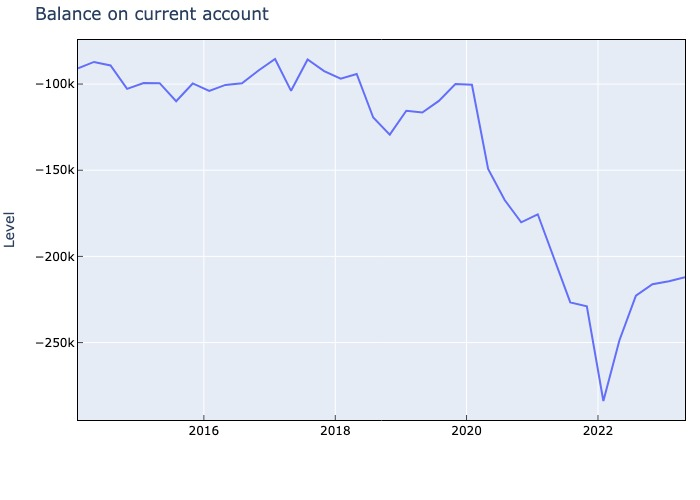

In [103]:
chartbook_panel('IEABC')

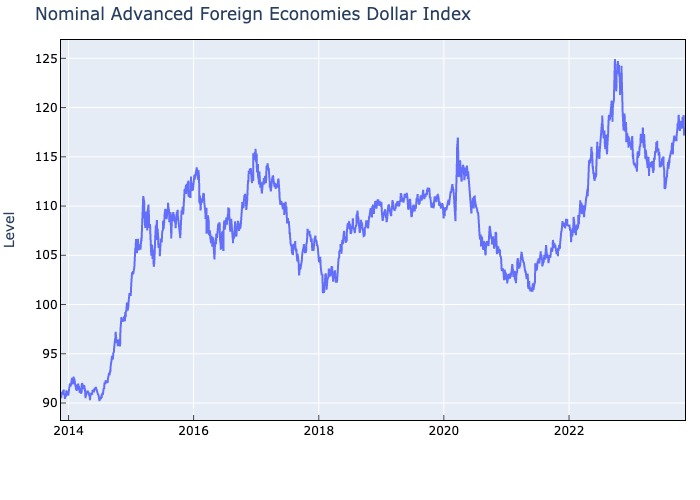

In [104]:
chartbook_panel('DTWEXAFEGS')

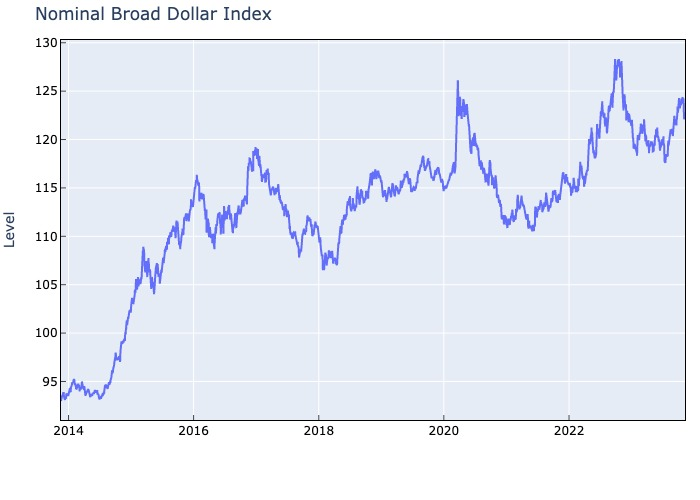

In [105]:
chartbook_panel('DTWEXBGS')

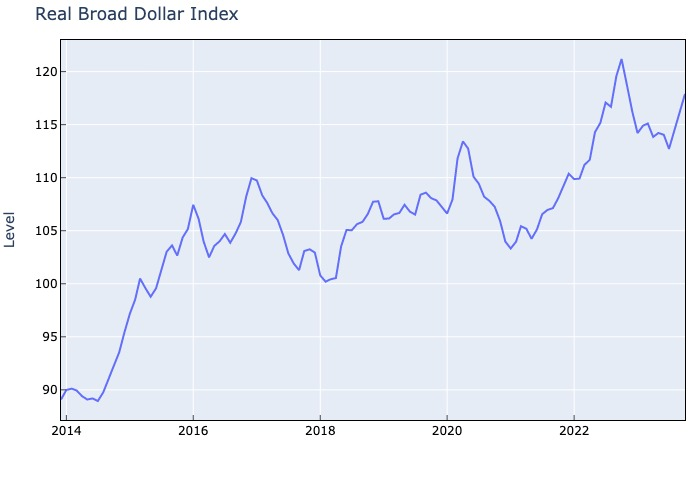

In [106]:
chartbook_panel('RTWEXBGS')

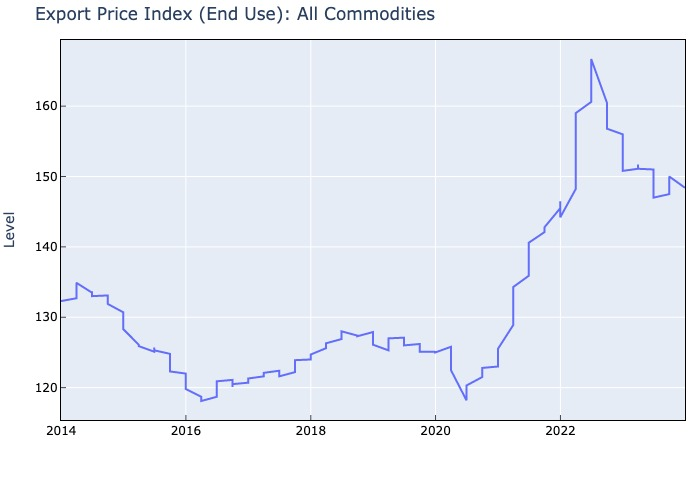

In [107]:
chartbook_panel('IQ')

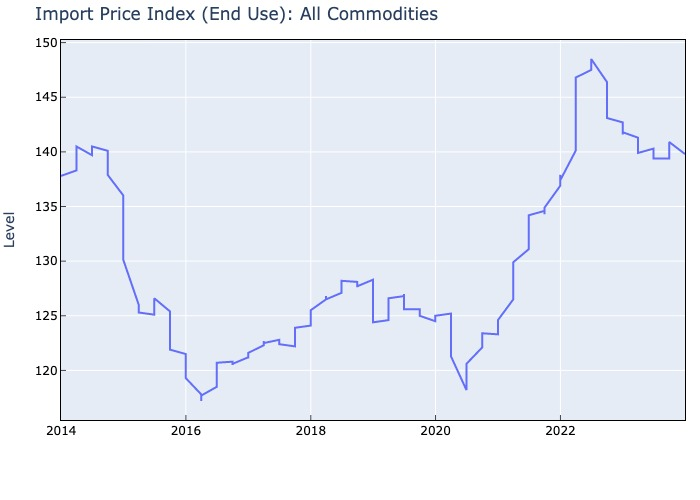

In [108]:
chartbook_panel('IR')

# Surveys

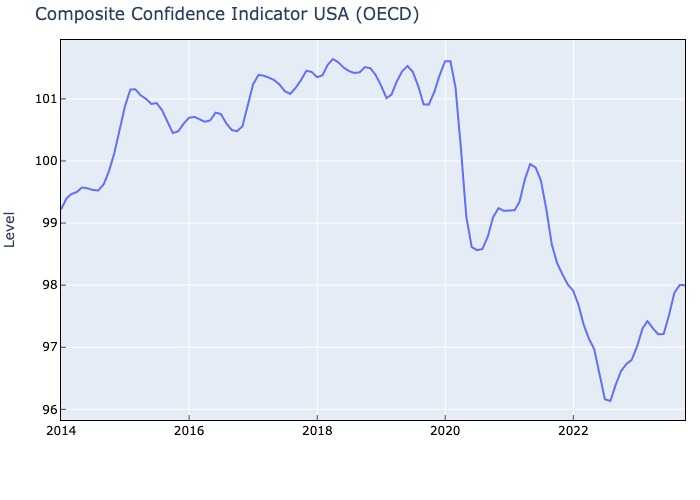

In [109]:
chartbook_panel('CSCICP03USM665S')

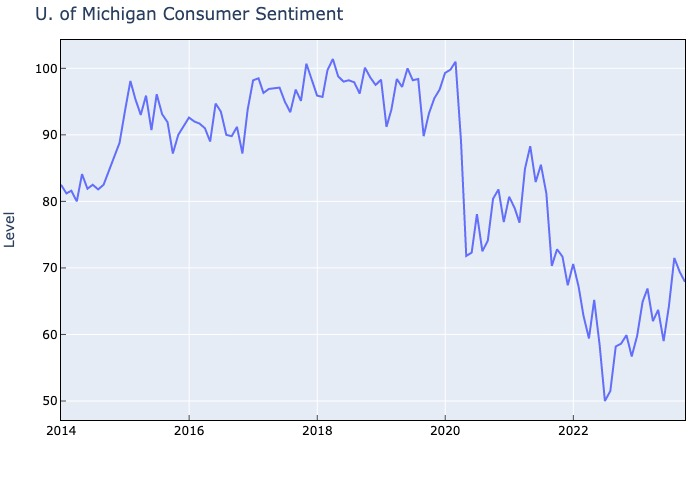

In [110]:
chartbook_panel('UMCSENT')

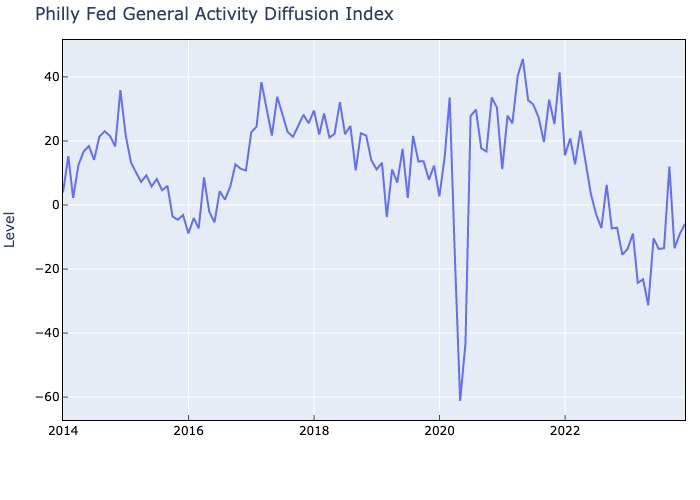

In [111]:
chartbook_panel('GACDFSA066MSFRBPHI')

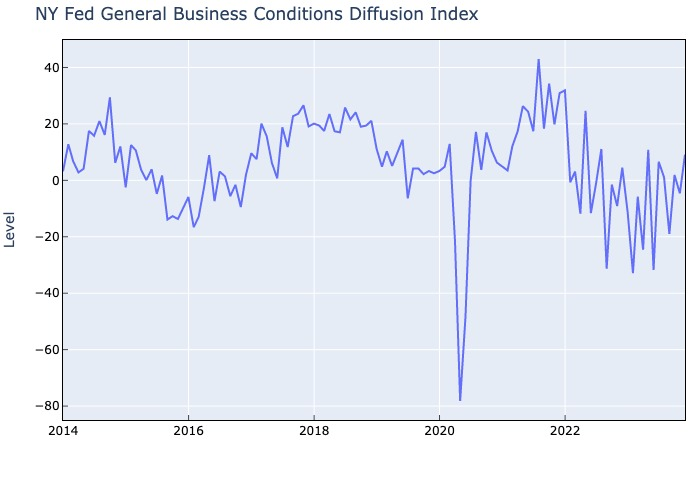

In [112]:
chartbook_panel('GACDISA066MSFRBNY')

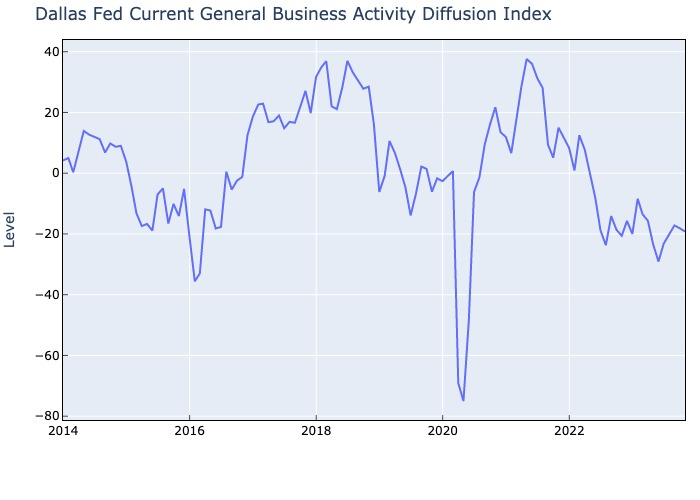

In [113]:
chartbook_panel('BACTSAMFRBDAL')

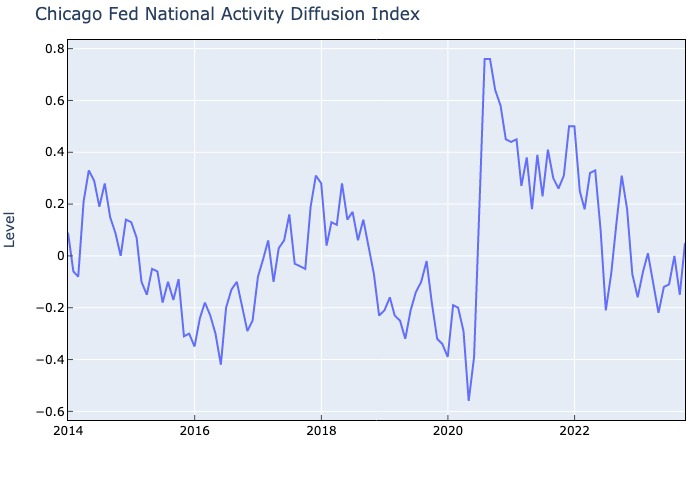

In [114]:
chartbook_panel('CFNAIDIFF')

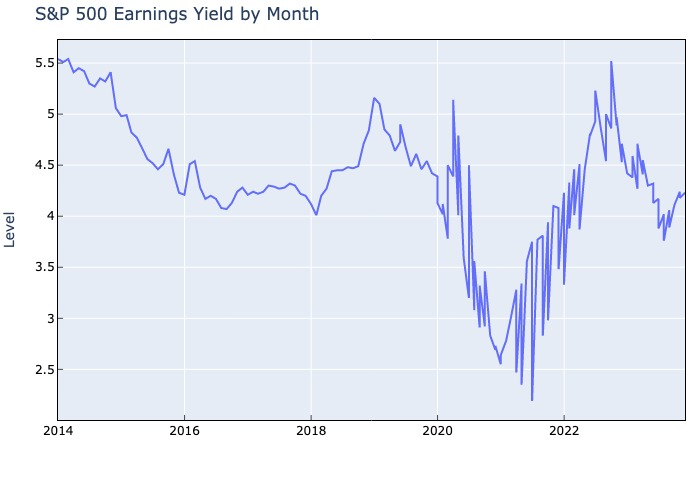

In [115]:
chartbook_panel('MULTPL_SP500_EARNINGS_YIELD_MONTH')

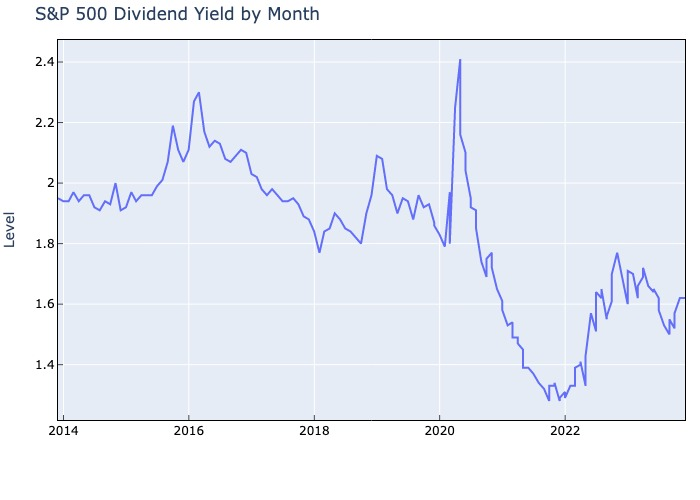

In [116]:
chartbook_panel('MULTPL_SP500_DIV_YIELD_MONTH')

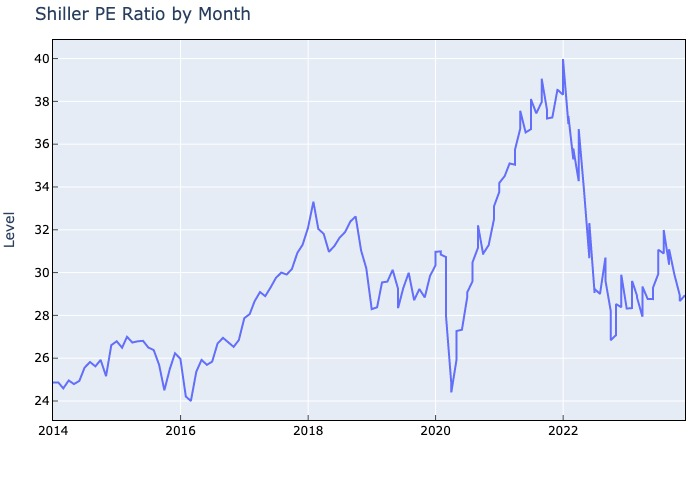

In [117]:
chartbook_panel('MULTPL_SHILLER_PE_RATIO_MONTH')

In [118]:
fred = Fred(api_key=os.environ["FRED_API_KEY"])
data = fred.get_series('SP500')
data

2013-11-18    1791.53
2013-11-19    1787.87
2013-11-20    1781.37
2013-11-21    1795.85
2013-11-22    1804.76
               ...   
2023-11-09    4347.35
2023-11-10    4415.24
2023-11-13    4411.55
2023-11-14    4495.70
2023-11-15    4502.88
Length: 2608, dtype: float64

In [119]:
info = fred.get_series_info('AHETPI')
print(info.title)
print(info.notes)
info

Average Hourly Earnings of Production and Nonsupervisory Employees, Total Private
Production and related employees include working supervisors and all nonsupervisory employees (including group leaders and trainees) engaged in fabricating, processing, assembling, inspecting, receiving, storing, handling, packing, warehousing, shipping, trucking, hauling, maintenance, repair, janitorial, guard services, product development, auxiliary production for plant's own use (for example, power plant), recordkeeping, and other services closely associated with the above production operations. #Nonsupervisory employees include those individuals in private, service-providing industries who are not above the working-supervisor level. This group includes individuals such as office and clerical workers, repairers, salespersons, operators, drivers, physicians, lawyers, accountants, nurses, social workers, research aides, teachers, drafters, photographers, beauticians, musicians, restaurant workers, custod

id                                                                      AHETPI
realtime_start                                                      2023-11-16
realtime_end                                                        2023-11-16
title                        Average Hourly Earnings of Production and Nons...
observation_start                                                   1964-01-01
observation_end                                                     2023-10-01
frequency                                                              Monthly
frequency_short                                                              M
units                                                         Dollars per Hour
units_short                                                         $ per Hour
seasonal_adjustment                                        Seasonally Adjusted
seasonal_adjustment_short                                                   SA
last_updated                                        

In [120]:
info = fred.get_series_info('PAYEMS')


In [121]:
base_url = "https://api.stlouisfed.org/fred"
key = f"?api_key={os.environ['FRED_API_KEY']}"
response = requests.get(f"{base_url}/releases{key}")

soup = BeautifulSoup(response.content, features="xml")

ids, links, names, notes, real_time_ends, sources = [], [], [], [], [], []
source_dict = {}
for ob in soup.find_all("release"):
    ids.append(ob.get('id'))
    links.append(ob.get('link'))
    names.append(ob.get('name'))
    notes.append(ob.get('notes'))
    real_time_ends.append(ob.get('realtime_end'))
    release_id = ob.get('id')
    source_url = f"{base_url}/release/sources?release_id={release_id}&api_key={os.environ['FRED_API_KEY']}"
    source_response = requests.get(source_url)
    source_ids = []
    if source_response:
f    sources.append(source_ids)

release_df = pd.DataFrame({'id': ids,
              'name': names,
              'link': links,
              'notes': notes,
              'real_time_end': real_time_ends,
              'source': sources
             })
release_df = release_df.set_index("id")
release_df


IndentationError: expected an indented block after 'if' statement on line 19 (175557597.py, line 20)

In [ ]:
INDICATORS['FRED']

In [ ]:
source_df = pd.DataFrame({'id': source_dict.keys(),
              'name': source_dict.items()})
source_df['id'] = source_df['id'].astype(int)
source_df['name'] = source_df['name'].apply(lambda t: t[1])
source_df = source_df.sort_values('id')
source_df = source_df.set_index('id')
source_df

In [ ]:
release_id = 9
tag_url = f"{base_url}/release/tags?release_id={release_id}&api_key={os.environ['FRED_API_KEY']}&order_by=popularity"
tag_response = requests.get(tag_url)
tag_soup = BeautifulSoup(tag_response.content, features="xml")
for tag in tag_soup.find_all("tag"):
    print(tag['name'])


In [ ]:
INDICATORS['FRED']

In [ ]:
# related tags
release_id = 9
tag_url = f"{base_url}/release/related_tags?release_id={release_id}&tag_names=retail&api_key={os.environ['FRED_API_KEY']}&order_by=popularity"
tag_response = requests.get(tag_url)
tag_soup = BeautifulSoup(tag_response.content, features="xml")
for tag in tag_soup.find_all("tag"):
    print(tag['name'])


In [ ]:
from functools import cache
@cache
def get_cat_by_id(cat_id):
    cat_url = f"{base_url}/category?category_id={cat_id}&api_key={os.environ['FRED_API_KEY']}"
    print(cat_url)
    cat_response = requests.get(cat_url)
    print(cat_response.content)
    cat_soup=BeautifulSoup(cat_response.content, features='xml')
    retarray = [{'id': cat.get('id'),
                  'name': cat.get('name'),
                  'notes': cat.get('notes'),
                  'parent_id': cat.get('parent_id')} for cat in cat_soup.find_all("category")]
        
    return retarray

get_cat_by_id('32991')


In [ ]:
from functools import cache
@cache
def get_cat_children(cat_id):
    cat_url = f"{base_url}/category/children?category_id={cat_id}&api_key={os.environ['FRED_API_KEY']}"
    cat_response = requests.get(cat_url)
    print(cat_response.content)
    cat_soup=BeautifulSoup(cat_response.content, features='xml')
    retarray = [{'id': cat.get('id'),
                  'name': cat.get('name'),
                  'notes': cat.get('notes'),
                  'parent_id': cat.get('parent_id')} for cat in cat_soup.find_all("category")]
        
    return retarray

get_cat_children('0')


In [ ]:
s = 'AHETPI'
def get_cats(s):
    series_cat_url = f"{base_url}/series/categories?series_id={s}&api_key={os.environ['FRED_API_KEY']}"
    series_cat_response = requests.get(series_cat_url)
    series_cat_soup = BeautifulSoup(series_cat_response.content, features="xml")
    retarray = [{'id': cat.get('id'),
                 'name': cat.get('name'),
                 'notes': cat.get('notes'),
                 'parent_id': cat.get('parent_id')} for cat in series_cat_soup.find_all("category")]
    parent_id=cat.get('parent_id')
    while parent_id and parent_id != '0':
        pid = get_cat_by_id(parent_id)
        retarray.extend(pid)
        parent_id = pid[0].get('parent_id')
    
    return retarray

get_cats(s)

                

In [ ]:
@cache
def get_release(s):
    series_release_url = f"{base_url}/series/release?series_id={s}&api_key={os.environ['FRED_API_KEY']}"
    series_release_response = requests.get(series_release_url)
    series_release_soup = BeautifulSoup(series_release_response.content, features="xml")
    retarray = [{'id': release.get('id'), 
                 'name': release.get('name'), 
                 'link': release.get('link')} for release in series_release_soup.find_all("release")]
    return retarray

get_release(s)


In [ ]:
def get_series_tags(s):
    series_tags_url = f"{base_url}/series/tags?series_id={s}&api_key={os.environ['FRED_API_KEY']}&order_by=popularity"
    series_tags_response = requests.get(series_tags_url)
    series_tags_soup = BeautifulSoup(series_tags_response.content, features="xml")
    
    retarray = [{'group_id': tag.get('group_id'), 
                 'name': tag.get('name'), 
                 'notes': tag.get('notes')} for tag in series_tags_soup.find_all("tag")]
    return retarray

get_series_tags(s)

In [ ]:
# fred/series/search - Get economic data series that match keywords.
def search_keyword_text(search_text):
    keyword_search_url= f"{base_url}/series/search?search_text={search_text}&api_key={os.environ['FRED_API_KEY']}&order_by=popularity"
    keyword_response = requests.get(keyword_search_url)
    keyword_soup = BeautifulSoup(keyword_response.content, features="xml")
    retarray = [{'id': series.get('id'), 
                 'title': series.get('title'), 
                 'freq': series.get('frequency_short'),
                 'units': series.get('units_short'),
                 'sa': series.get('seasonal_adjustment_short')} for series in keyword_soup.find_all("series")]
    return retarray

search_keyword_text('consumer+credit')


In [ ]:
fred.search_by_category(101, limit=10, order_by='popularity', sort_order='desc')


In [ ]:
fred.search('potential gdp', order_by='popularity')


In [ ]:

INDICATORS['FRED'].keys()

In [ ]:
from collections import deque


In [ ]:
# top level categories
fredcats = {}
q = deque(["0"])

while (q):
    cat = q.popleft()
    catdict = get_cat_by_id(cat)[0]
    children = get_cat_children(cat)
    child_ids = [child['id'] for child in children]
    child_ids.sort()
    catdict['children'] = child_ids
    fredcats[cat] = catdict
    q.extend(child_ids)

    

In [ ]:
catlist = []
for s in fredcats.keys():
    cat_url = f"{base_url}/category?category_id={s}&api_key={os.environ['FRED_API_KEY']}&file_type=json"
    series_cat_response = requests.get(cat_url)
    print(series_cat_response.content)
    mydict = json.loads(series_cat_response.content)
    catlist.append(mydict['categories'][0])


In [ ]:
catlist

In [ ]:
cat_df = pd.DataFrame.from_dict(pd.json_normalize(catlist), orient='columns') \
    .sort_values('id') \
    .reset_index(drop=True)
cat_df

In [ ]:
print(cat_df[['id', 'name', 'parent_id']].to_csv(index=False))

In [ ]:
"""You are an economics research assistant whose role is to identify a data series from the FRED database for further analysis.

FRED contain approximately 800000 series relating to the US economy.

the series are organized into the following categories:
category_id,name,category_parent_id
0,Categories,0
1,Production & Business Activity,0
2,Productivity & Costs,10
3,Industrial Production & Capacity Utilization,1
6,Retail Trade,1
10,"Population, Employment, & Labor Markets",0
11,Current Employment Statistics (Establishment Survey),10
12,Current Population Survey (Household Survey),10
97,Housing,1
104,Population,10
3008,U.S. Regional Data,0
27281,States,3008
32043,Census Regions,3008
32061,BEA Regions,3008
32071,Federal Reserve Districts,3008
32216,Health Insurance,1
32233,Freddie Mac Regions,3008
32240,Weekly Initial Claims,10
32241,Job Openings and Labor Turnover (JOLTS),10
32250,ADP Employment,10
32262,Business Cycle Expansions & Contractions,1
32263,International Data,0
32429,Manufacturing,1
32436,Construction,1
32455,Prices,0
32991,"Money, Banking, & Finance",0
32992,National Accounts,0
33001,Income Distribution,10
33060,Academic Data,0
33202,Transportation,1
33203,Wholesale Trade,1
33441,Services,1
33490,Finance Companies,1
33492,Technology,1
33500,Education,10
33509,Labor Market Conditions,10
33731,Tax Data,10
33831,Minimum Wage,10
33936,Business Surveys,1
33940,Emissions,1
33955,Expenditures,1
33959,Patents,1

you have access to functions that can 
- look up a list of categories that match series keywords
- look up a list of series in a category by category_id
- detailed information about the series.
- look up a list of series by series keywords

I will ask a question that I am studying. You will ask a series of questions to clarify the best series to answer the question.

Examples of questions might be:
It sounds like you are asking about `category`. Is that correct?
It sounds like you are asking about one of these categories: `categories`. Which one of these categories do you think most closely matches the series you are looking for?
Are you looking for currency values or an index?
Are you looking for nominal values or inflation-adjusted (real) values as of a basse period?
Are you looking for seasonally adjusted (SA) or non seasonally adjusted values?

termination condition
"""




In [ ]:
import pandas as pd

data = [
    {
        'name': {
            'first': 'Alice',
            'last': 'Smith'
        },
        'age': 27
    },
    {
        'name': {
            'first': 'Bob',
            'last': 'Johnson'
        },
        'age': 32
    }
]

df = pd.DataFrame.from_dict(pd.json_normalize(data), orient='columns')
df

In [ ]:
# df = pd.DataFrame({'cost':    [0.227,  0.332, 0.37, 0.5, 0.6, 0.83],
#                    'benefit': [0.515, 0.55, 0.625, 0.7, 0.8, 0.9]})
# labels = ["1. Policies, Controls, Monitoring",
#           "2. Best Practices, Documentation and Training",
#           "3. Simple Workflow Automation",
#           "4. Question Answering Over Internal Data",
#           "5. Complex Workflow Automation & Agents",
#           "6. Custom LLM models"
#          ]

# df

In [ ]:
# fig = go.Figure(
#     data=[go.Scatter(x=df['cost'].to_list(),
#                      y=df['benefit'].to_list(),
#                      line_width=2,
#                      mode='text',
#                      textposition='top center',
#                      text=labels,
#                      textfont=dict(
#                          family="Arial",
#                          size=18, 
#                          color="Black"
#                      )
#                     ),
#          ],
#     layout=dict(
#     autosize=True,
#             width=640,
#             height=640,            
#             margin={'l': 10, 'r': 15, 't': 40},
#             paper_bgcolor="white",
#             #plot_bgcolor="white",
#             showlegend=False,
#             legend=dict(
#                 orientation="h",
#                 yanchor="bottom",
#                 y=1.02,
#                 xanchor="left",
#                 x=0
#             ),
#             xaxis={
#                 'range': [0, 1],                
#                 'ticks': 'inside',
#                 'tick0': 0.0, 
#                 'dtick': 0.5,                
#                 'showgrid': True,            # thin lines in the background
#                 'zeroline': False,           # thick line at x=0
#                 'visible': True,             # numbers below
#                 'showline': True,            # Show X-Axis
#                 'linecolor': 'black',        # Color of X-axis
#                 'tickfont_color': 'black',   # Color of ticks
#                 'tickfont_size' : 16,                
#                 'showticklabels': True,      # Show X labels
#                 'mirror': True,              # draw right axis
#             },
#             yaxis={
#                 'range': [0, 1],
#                 'ticks': 'inside',
#                 'tick0': 0.0, 
#                 'dtick': 0.5,                
#                 'showgrid': True,            # thin lines in the background
#                 'zeroline': False,           # thick line at x=0
#                 'visible': True,             # numbers below
#                 'showline': True,            # Show X-Axis
#                 'linecolor': 'black',        # Color of X-axis
#                 'tickfont_color': 'black',   # Color of ticks
#                 'tickfont_size' : 16,
#                 'showticklabels': True,      # Show X labels
#                 'side': 'left',
#                 'mirror': True,
#             },
#         )    
# )

# fig.update_layout(dict(title='Quadrant Chart / 2 x 2 matrix',
#                        yaxis={'title': 'Benefit or Reward',
#                              'titlefont': {'size': 18}},
#                        xaxis={'title':'Cost or Risk',
#                               'titlefont': {'size': 18}},
#                       ))

# # ?    yaxis = list(titlefont = list(size = 25), title = "test"))

